<a href="https://colab.research.google.com/github/V1vd/Traffic-Lights-detection-with-YOLOv5/blob/main/Traffic%20Lights%20Detection%20YOLOv5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Импорт модели YOLOv5 и необходимых библиотек


Целью дипломного проекта является обучить нейронную сеть обнаруживать и распознавать цвет светофора. 

Для достижения данной цели была выбрана архитектура YOLOv5

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!git clone https://github.com/ultralytics/yolov5 #клонируем модель с github репозитория в директорию данного ноутбука  
%cd yolov5 
%pip install -qr requirements.txt 

Cloning into 'yolov5'...
remote: Enumerating objects: 12445, done.
remote: Total 12445 (delta 0), reused 0 (delta 0), pack-reused 12445
Receiving objects: 100% (12445/12445), 11.59 MiB | 27.41 MiB/s, done.
Resolving deltas: 100% (8666/8666), done.
/content/yolov5
     |████████████████████████████████| 596 kB 6.8 MB/s 


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image

In [ ]:
import torch
from yolov5 import utils
display = utils.notebook_init()

YOLOv5 🚀 v6.1-95-gea72b84 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 39.9/78.2 GB disk)


In [ ]:
!python detect.py --weights yolov5s.pt --img 640 --conf 0.25 --source data/images #запуск детекции на дефолтных примерах (проверка работы)


detect: weights=['yolov5s.pt'], source=data/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-95-gea72b84 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

100% 14.1M/14.1M [00:00<00:00, 45.9MB/s]

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.5 GFLOPs
image 1/2 /content/yolov5/data/images/bus.jpg: 640x480 4 persons, 1 bus, Done. (0.015s)
image 2/2 /content/yolov5/data/images/zidane.jpg: 384x640 2 persons, 2 ties, Done. (0.020s)
Speed: 0.4ms pre-process, 17.6ms inference, 15.6ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp


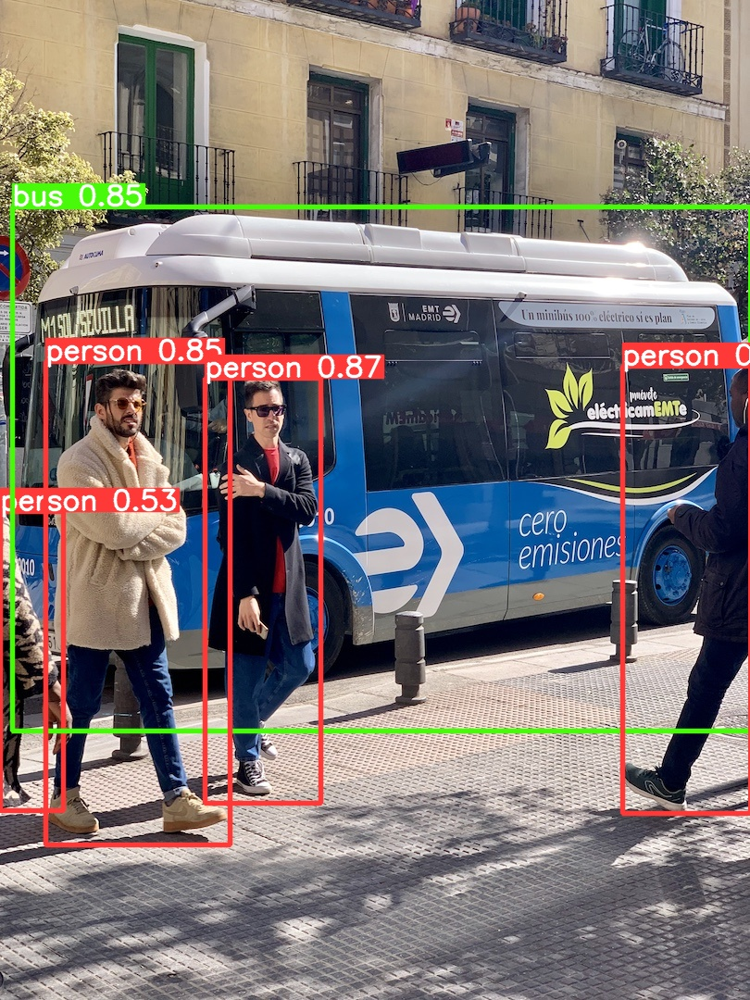

In [ ]:
display.Image(filename='runs/detect/exp/bus.jpg', width=600) #вывод 1го распознанного примера

# **Обучаем** на 200 эпохах 

**В первую очередь подготовимся к обучению. Для этого необходимо создать файл с архитектурой, которая будет соответсвовать поставленной задаче.**

Файл **new_train_yaml** содержит количество классов (в нашем случае это 4 класса: зеленый, желтый, красный и неизвестный светофор) сопоставленное с архитектурой нашей сети. 

In [ ]:
with open('new_train_yaml', 'w+') as file:
    file.write(
        """
        # параметры
        nc: 4  # число классов
        depth_multiple: 0.33  
        width_multiple: 0.50  

        anchors:
          - [10,13, 16,30, 33,23]  # P3/8
          - [30,61, 62,45, 59,119]  # P4/16
          - [116,90, 156,198, 373,326]  # P5/32

        #backbone
        backbone:
          # [from, number, module, args]
          [[-1, 1, Focus, [64, 3]],  # 0-P1/2
           [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
           [-1, 3, BottleneckCSP, [128]],
           [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
           [-1, 9, BottleneckCSP, [256]],
           [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
           [-1, 9, BottleneckCSP, [512]],
           [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
           [-1, 1, SPP, [1024, [5, 9, 13]]],
           [-1, 3, BottleneckCSP, [1024, False]],  # 9
          ]

        #head
        head:
          [[-1, 1, Conv, [512, 1, 1]],
           [-1, 1, nn.Upsample, [None, 2, 'nearest']],
           [[-1, 6], 1, Concat, [1]],  # cat backbone P4
           [-1, 3, BottleneckCSP, [512, False]],  # 13

           [-1, 1, Conv, [256, 1, 1]],
           [-1, 1, nn.Upsample, [None, 2, 'nearest']],
           [[-1, 4], 1, Concat, [1]],  # cat backbone P3
           [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

           [-1, 1, Conv, [256, 3, 2]],
           [[-1, 14], 1, Concat, [1]],  # cat head P4
           [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

           [-1, 1, Conv, [512, 3, 2]],
           [[-1, 10], 1, Concat, [1]],  # cat head P5
           [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

           [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
          ]
        """
    )

Файл **new_data_yaml** будет содержать информацию о местоположении данных для обучения, а также описание для классов. 

In [ ]:
with open('first_data_yaml', 'w+') as file:
  file.write(
      """
      train: /content/drive/My Drive/AIData/traffic lights/train/images
      val: /content/drive/My Drive/AIData/traffic lights/valid/images

      nc: 4
      names: ['green tl', 'red tl', 'unknown tl', 'yellow tl']
      """
  )

Ниже представлена команда для первой стадии обучения. После неё были сохранены веса  в файле **best.pt** по следующему пути: yolov5/runs/train/exp.

Модель была обучена на 100 эпохах после чего веса были скачены на пк и переименованы, далее файл имеет название **best100ep.pt**

*P.S. Результаты процесса обучения слетели, так как я испытывал методику дообучения используя эту команду.*

In [ ]:
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 5 --data /content/yolov5/new_data_yaml --cfg /content/yolov5/new_train_yaml

train: weights=yolov5s.pt, cfg=/content/yolov5/new_train_yaml, data=/content/yolov5/new_data_yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-73-gd51f9b2 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, h

**Далее мы проводим дополнительное обучение ещё на 100 эпохах, на тех же данных, взяв за основу веса с предыдущего этапа обучения.**

In [ ]:
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 100 --data /content/yolov5/new_data_yaml --weights /content/best100ep.pt

train: weights=/content/best100ep.pt, cfg=, data=/content/yolov5/new_data_yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-72-gee77632 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=

# **Визуализация результатов обучения** после 200 эпох. 

In [ ]:
from utils.plots import plot_results 
plot_results('/content/yolov5/runs/train/exp2/results.csv')


In [ ]:
x = pd.read_csv('/content/drive/MyDrive/dipl/результаты после 2го обучения на 100 эпох/results.csv')

In [ ]:
x.head(20)

,epoch,train/box_loss,train/obj_loss,train/cls_loss,metrics/precision,...,val/obj_loss,val/cls_loss,x/lr0,x/lr1,x/lr2
0,0,0.063626,0.010396,0.008780,0.86785,...,0.006548,0.009491,0.003310,0.003310,0.070213
1,1,0.065582,0.010314,0.009450,0.82096,...,0.006694,0.010503,0.006577,0.006577,0.040147
2,2,0.069418,0.010669,0.010110,0.67980,...,0.007003,0.015793,0.009779,0.009779,0.010015
3,3,0.072679,0.010763,0.012035,0.75135,...,0.007215,0.011735,0.009703,0.009703,0.009703
4,4,0.072297,0.011388,0.012463,0.71894,...,0.007650,0.015617,0.009703,0.009703,0.009703
5,5,0.073250,0.011596,0.012366,0.76505,...,0.007071,0.010359,0.009604,0.009604,0.009604
6,6,0.071774,0.011362,0.012503,0.82082,...,0.006904,0.011382,0.009505,0.009505,0.009505
7,7,0.072611,0.011020,0.012075,0.76796,...,0.006928,0.011709,0.009406,0.009406,0.009406
8,8,0.071107,0.011357,0.011386,0.77696,...,0.006901,0.010091,0.009307,0.009307,0.009307
9,9,0.071366,0.011519,0.011567,0.77229,...,0.007133,0.011796,0.009208,0.009208,0.009208


Изображение ниже показывает распределение классов и их параметров в нашем датасете

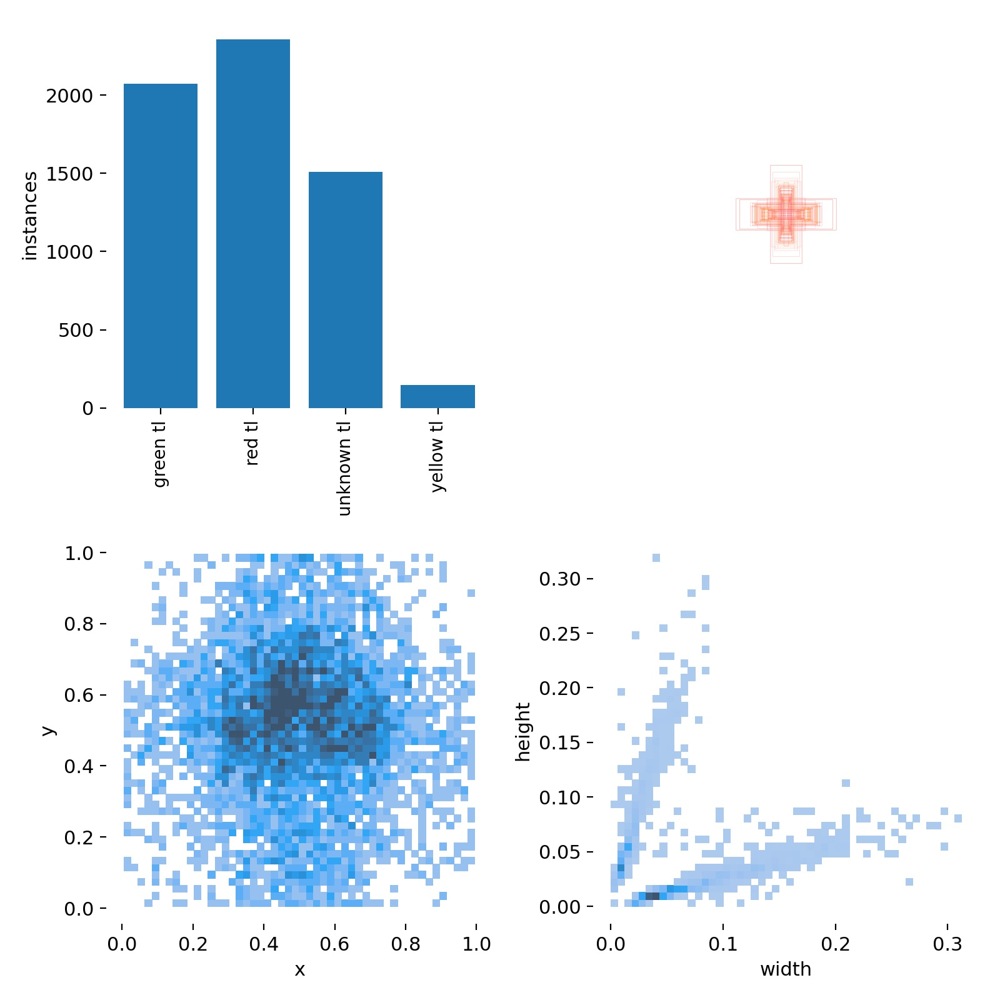

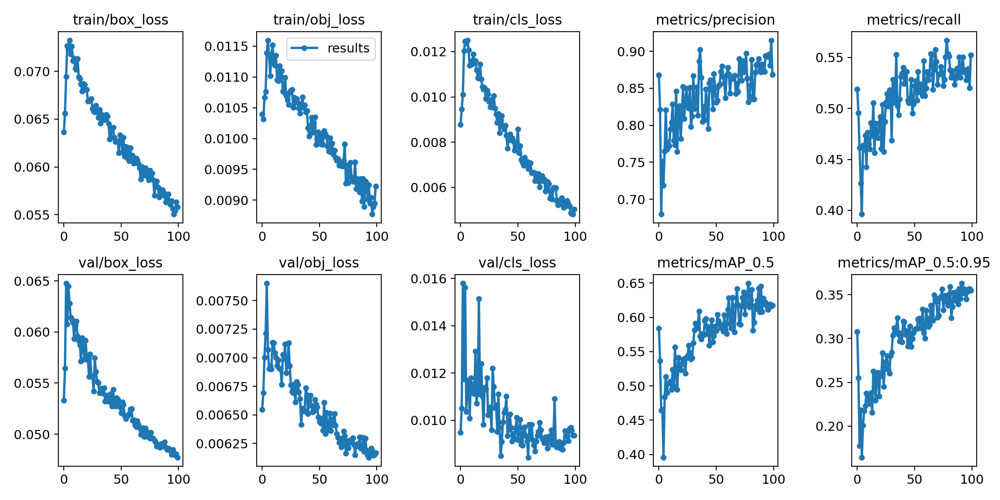

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp2/results.png', width=1000)

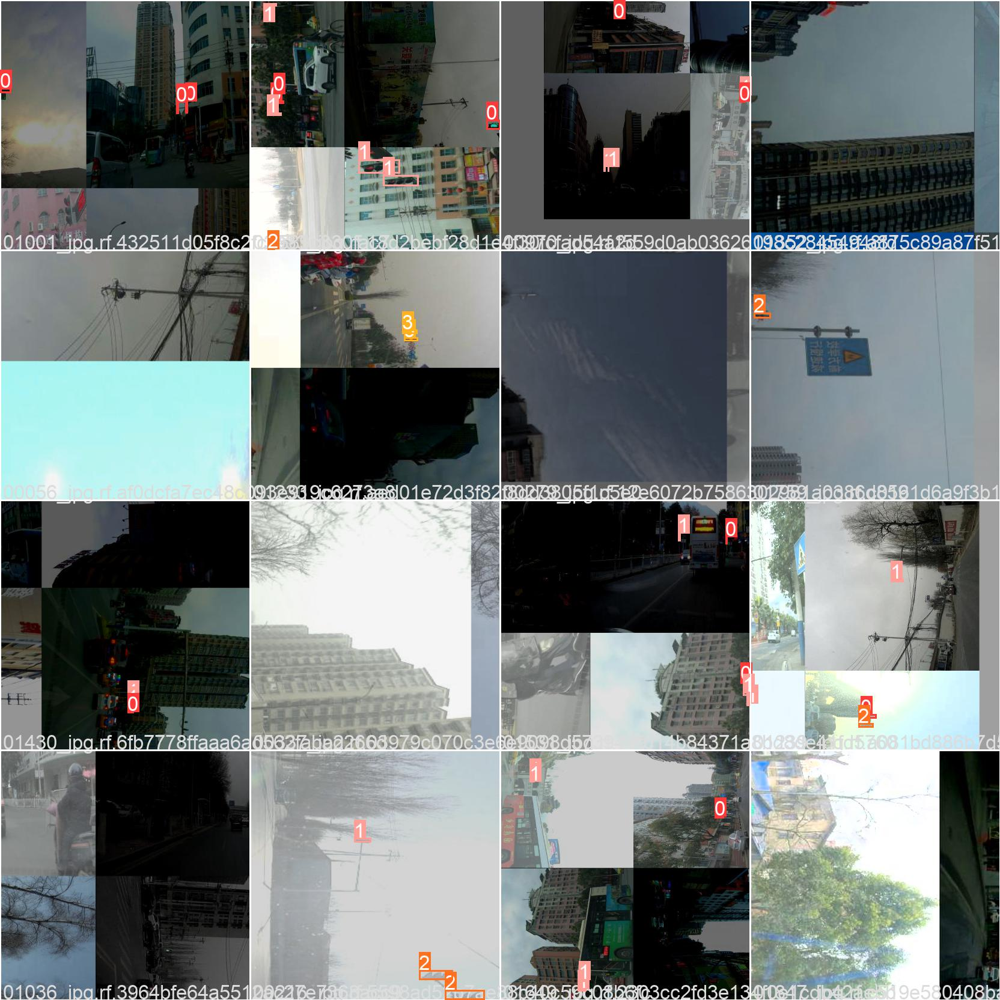

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp2/train_batch0.jpg', width=1000)

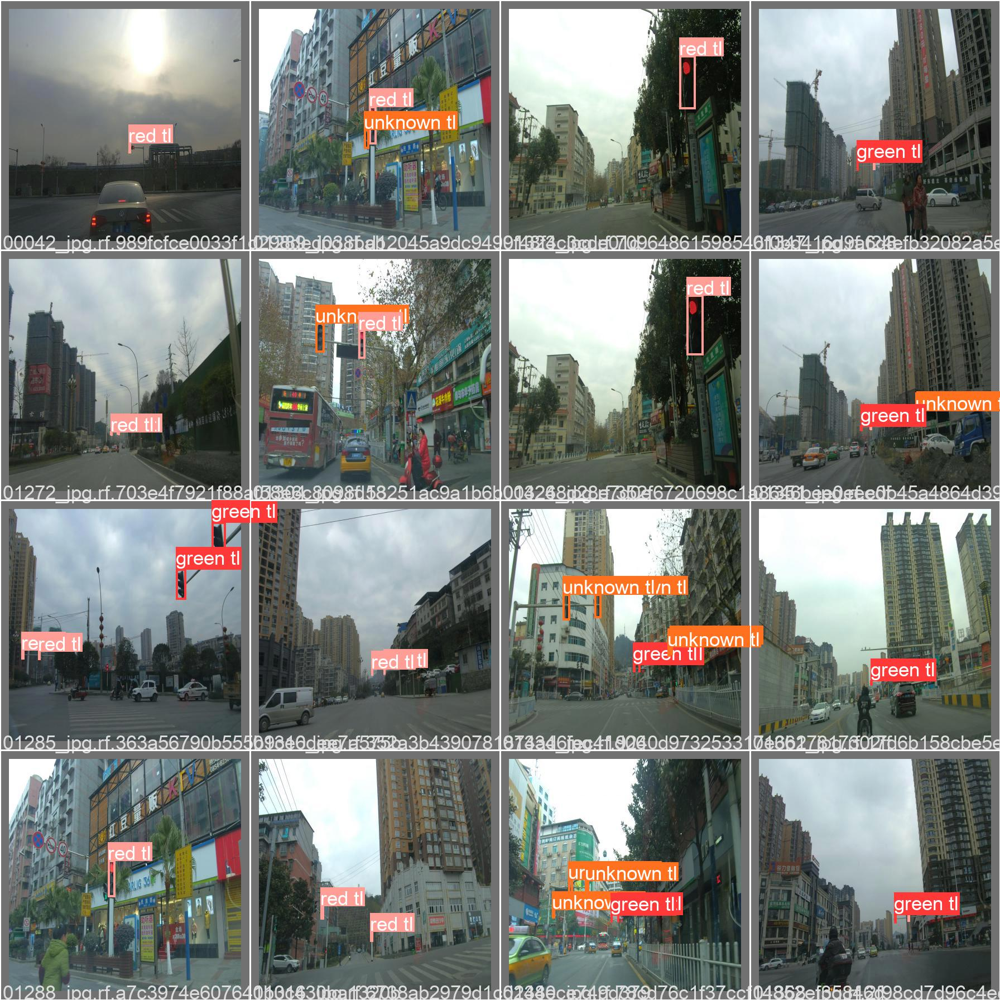

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp2/val_batch0_labels.jpg', width=1000)

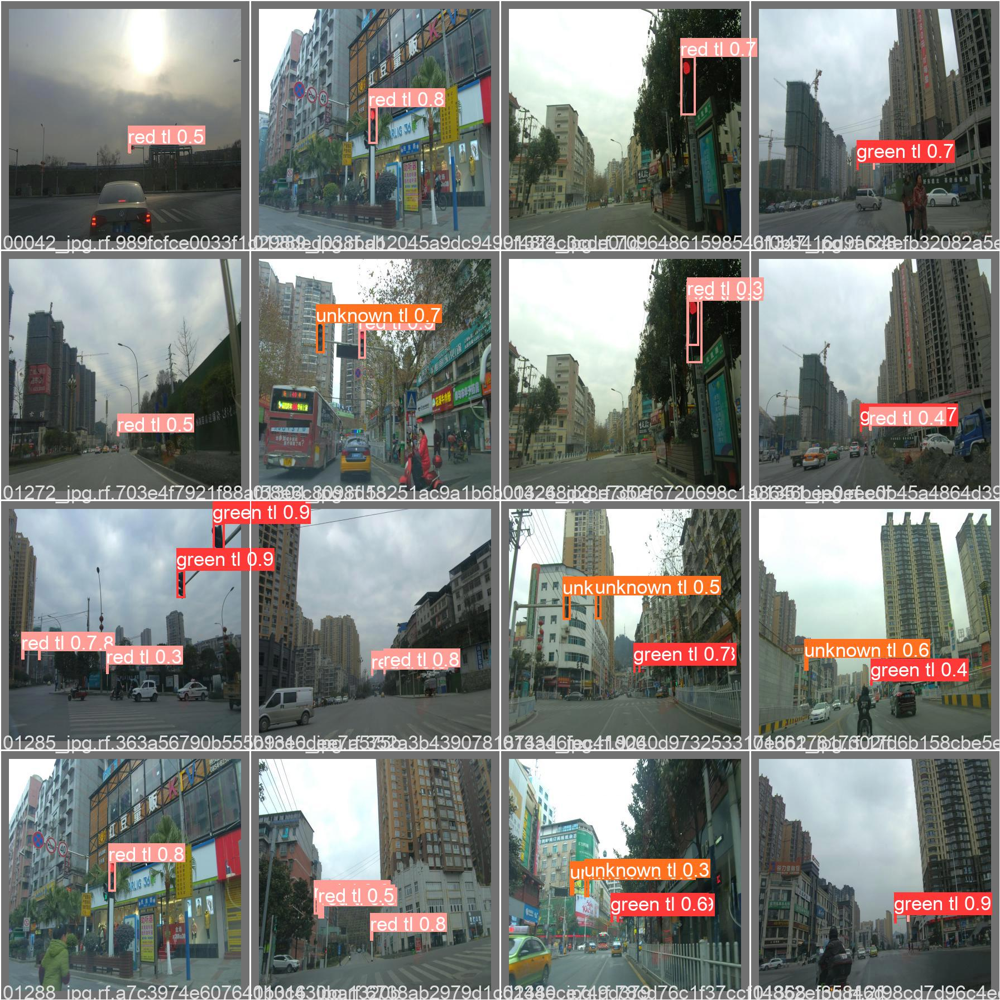

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp2/val_batch0_pred.jpg', width=1000)

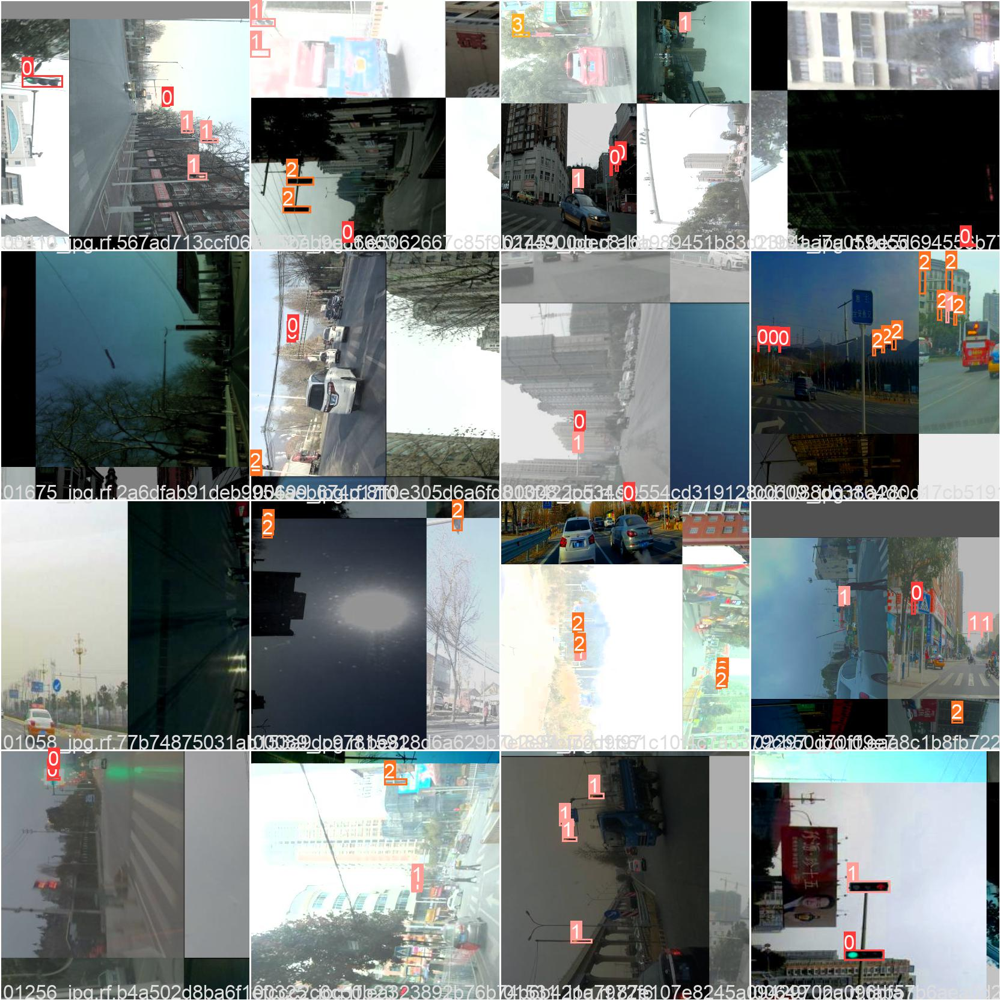

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp2/train_batch1.jpg', width=1000)

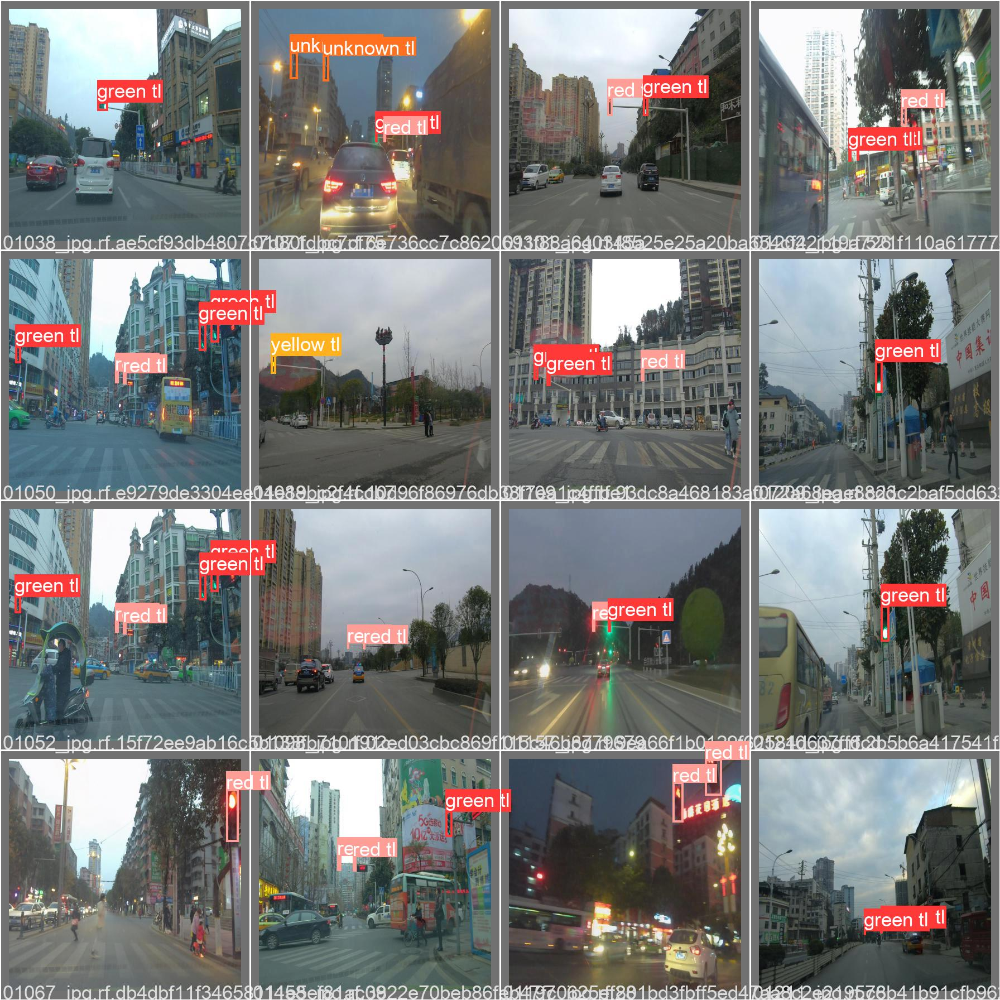

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp2/val_batch1_labels.jpg', width=1000)

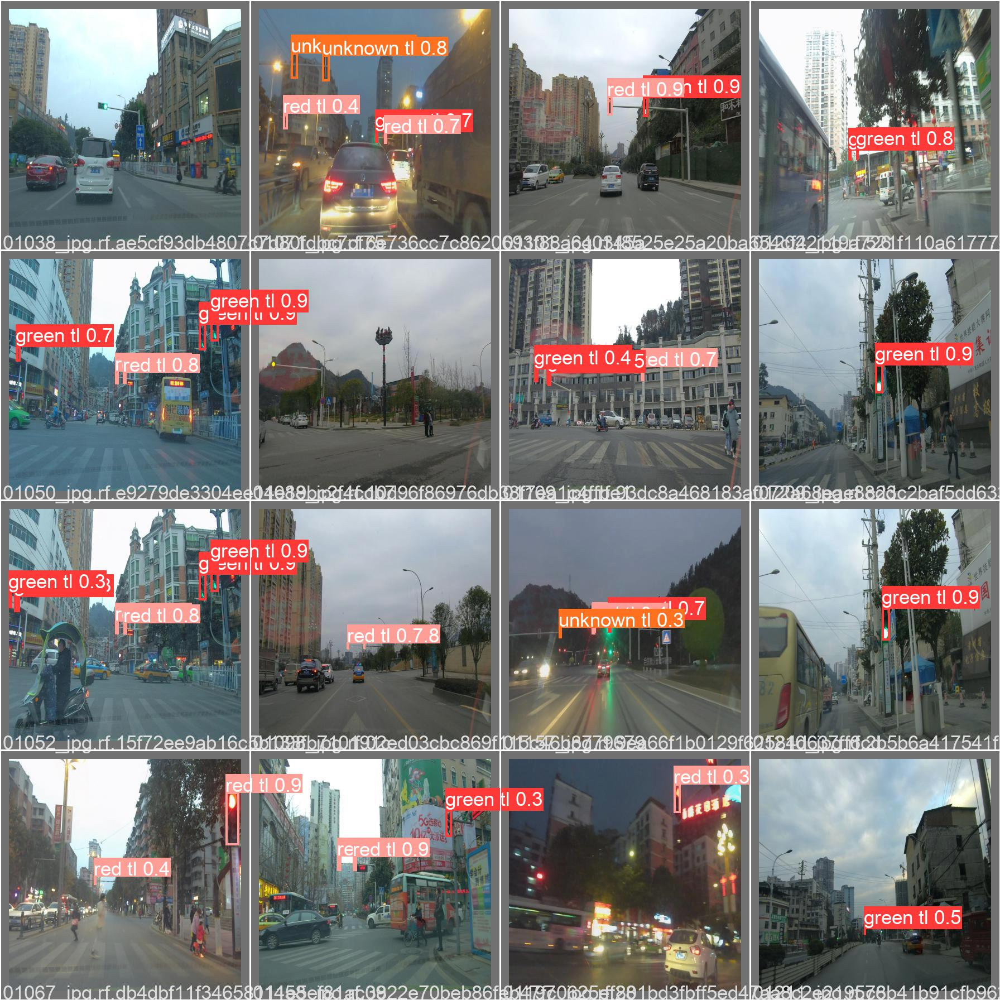

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp2/val_batch1_pred.jpg', width=1000)

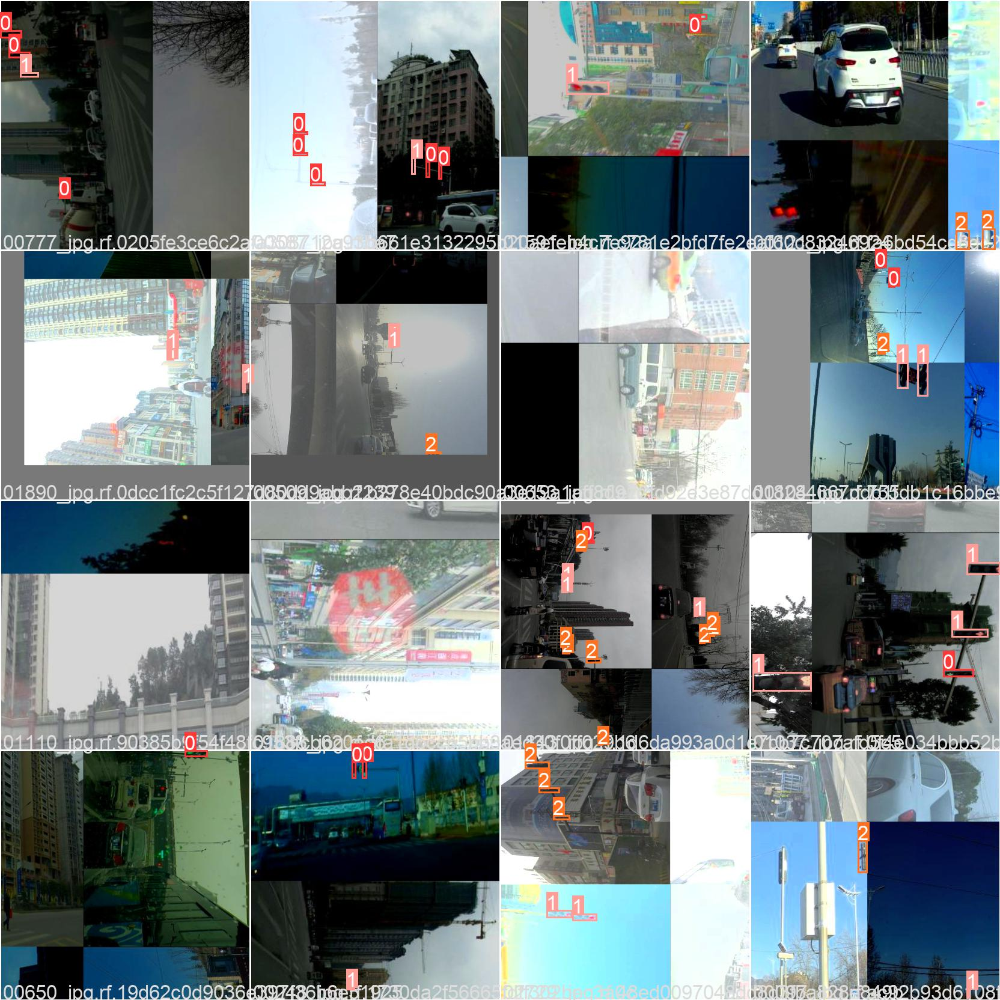

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp2/train_batch2.jpg', width=1000)

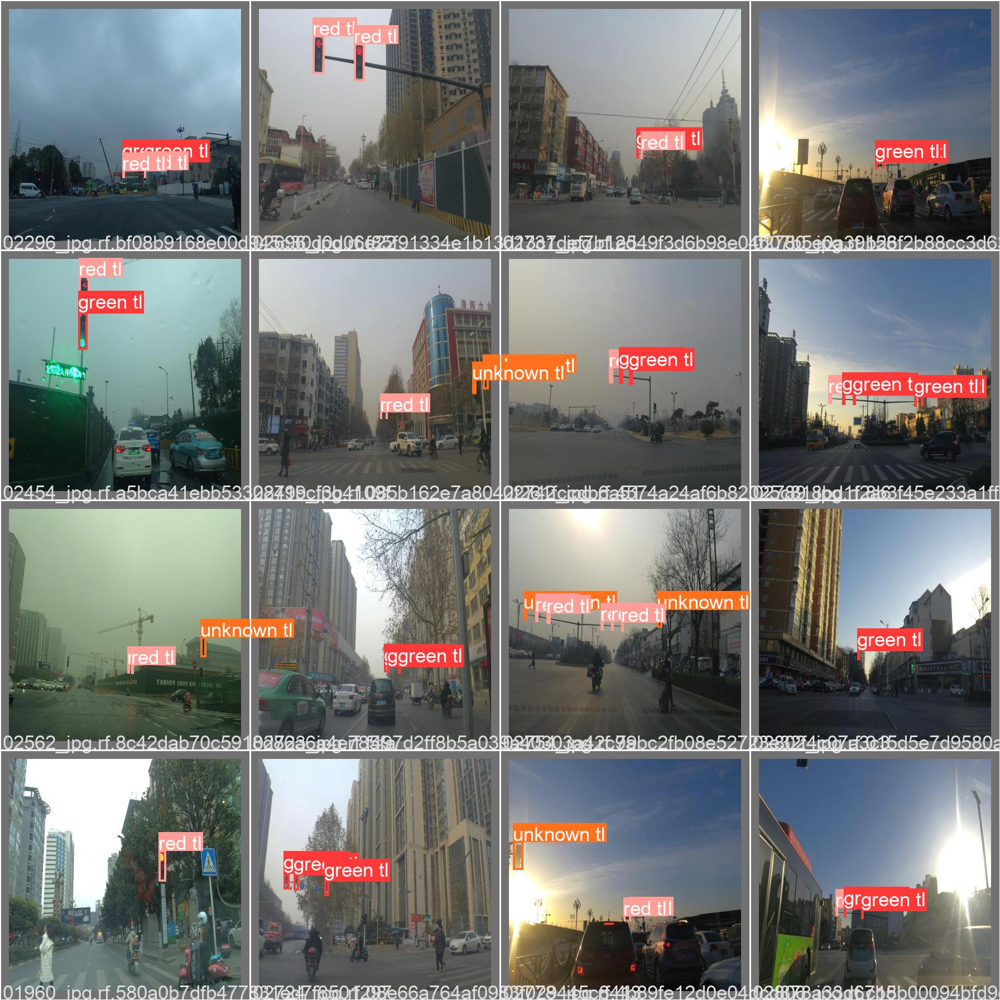

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp2/val_batch2_labels.jpg', width=1000)

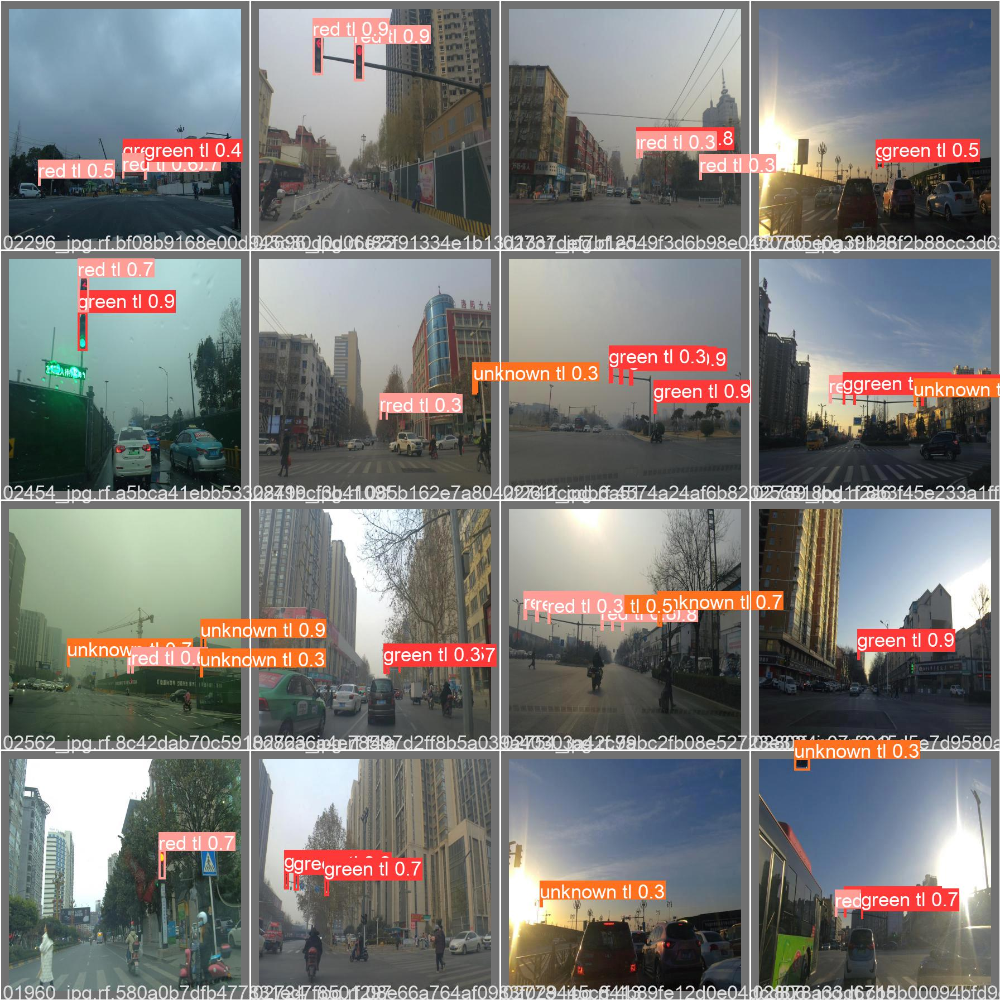

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp2/val_batch2_pred.jpg', width=1000)

# **Тестирование** модели после 200 эпох

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/1.jpg

detect: weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], source=/content/1.jpg, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-72-gee77632 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/1.jpg: 288x416 2 green tls, Done. (0.018s)
Speed: 0.3ms pre-process, 17.9ms inference, 1.3ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp2
1 labels saved to runs/detect/exp2/labels


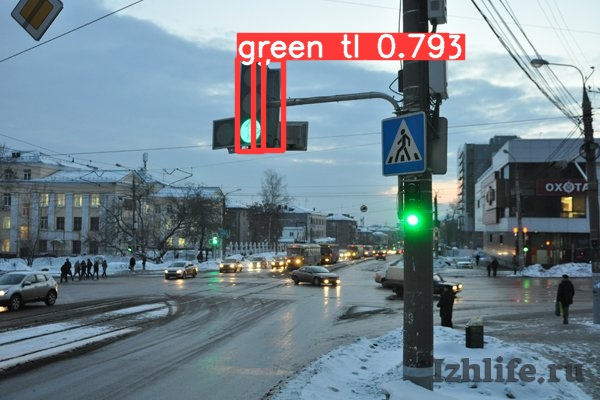

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp2/1.jpg', width=600)

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/2.jpg

detect: weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], source=/content/2.jpg, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-72-gee77632 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/2.jpg: 288x416 Done. (0.026s)
Speed: 0.4ms pre-process, 25.5ms inference, 0.6ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp3
0 labels saved to runs/detect/exp3/labels


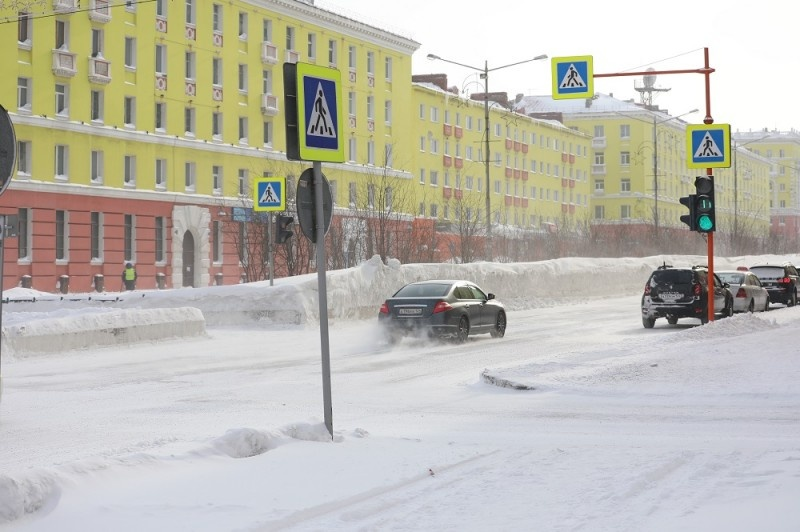

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp3/2.jpg', width=600)

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/3.jpg

detect: weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], source=/content/3.jpg, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-72-gee77632 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/3.jpg: 320x416 2 unknown tls, Done. (0.020s)
Speed: 0.4ms pre-process, 19.6ms inference, 1.3ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp4
1 labels saved to runs/detect/exp4/labels


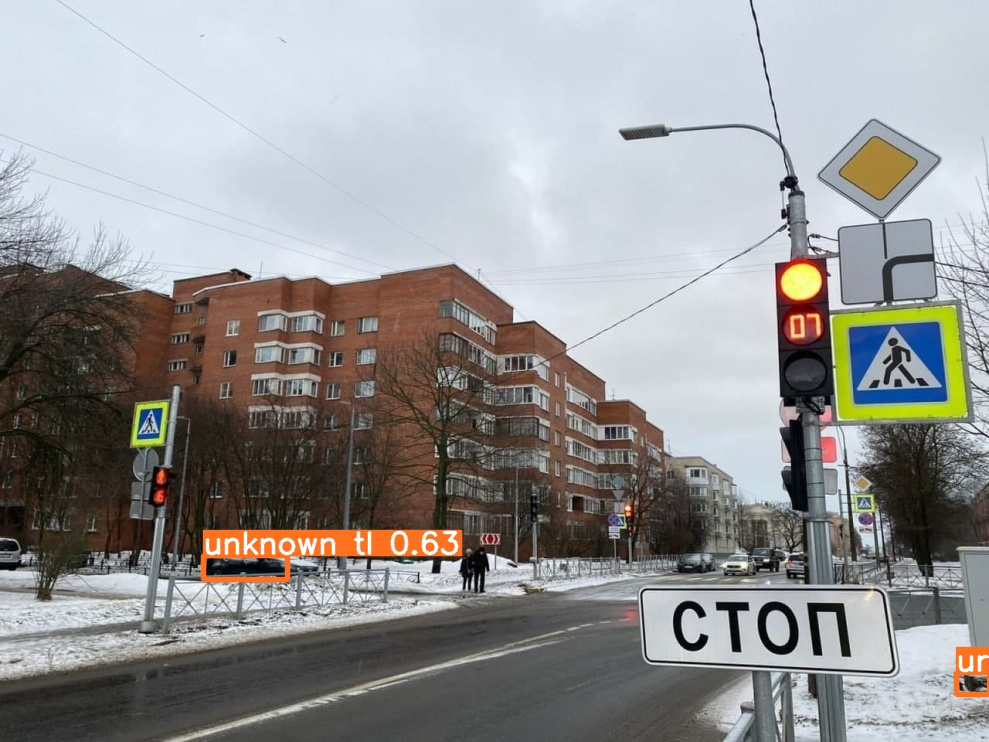

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp4/3.jpg', width=600)

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/4.JPG

detect: weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], source=/content/4.JPG, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-72-gee77632 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/4.JPG: 288x416 2 red tls, Done. (0.015s)
Speed: 0.3ms pre-process, 15.4ms inference, 1.2ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp6
1 labels saved to runs/detect/exp6/labels


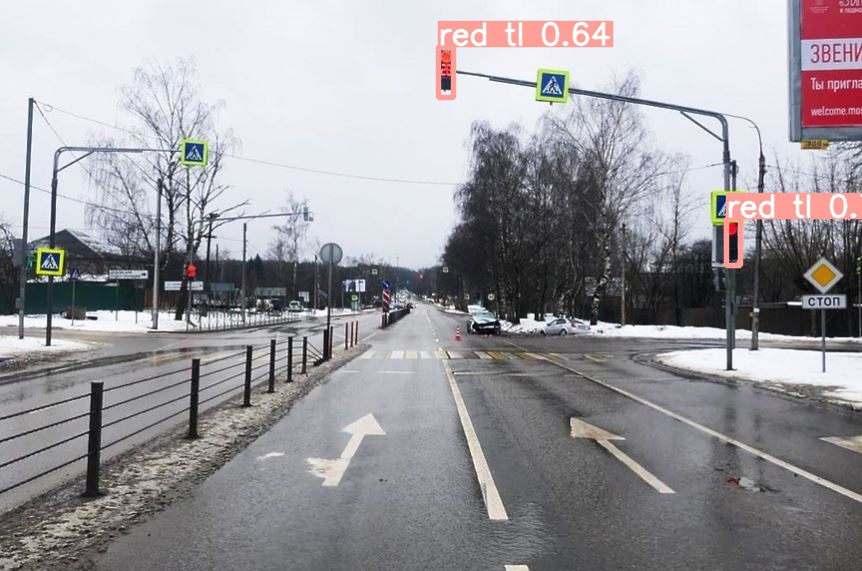

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp6/4.JPG', width=600)

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/46.jpg

detect: weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], source=/content/46.jpg, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-72-gee77632 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/46.jpg: 224x416 Done. (0.015s)
Speed: 0.3ms pre-process, 14.9ms inference, 0.3ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp7
0 labels saved to runs/detect/exp7/labels


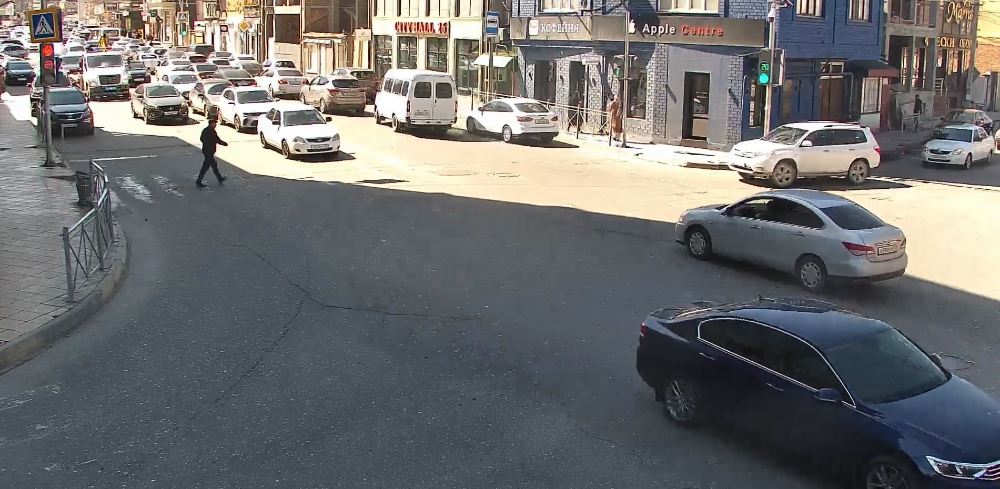

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp7/46.jpg', width=600)

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/23.JPG

detect: weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], source=/content/23.JPG, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-72-gee77632 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/23.JPG: 256x416 1 red tl, Done. (0.015s)
Speed: 0.3ms pre-process, 15.0ms inference, 1.3ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp9
1 labels saved to runs/detect/exp9/labels


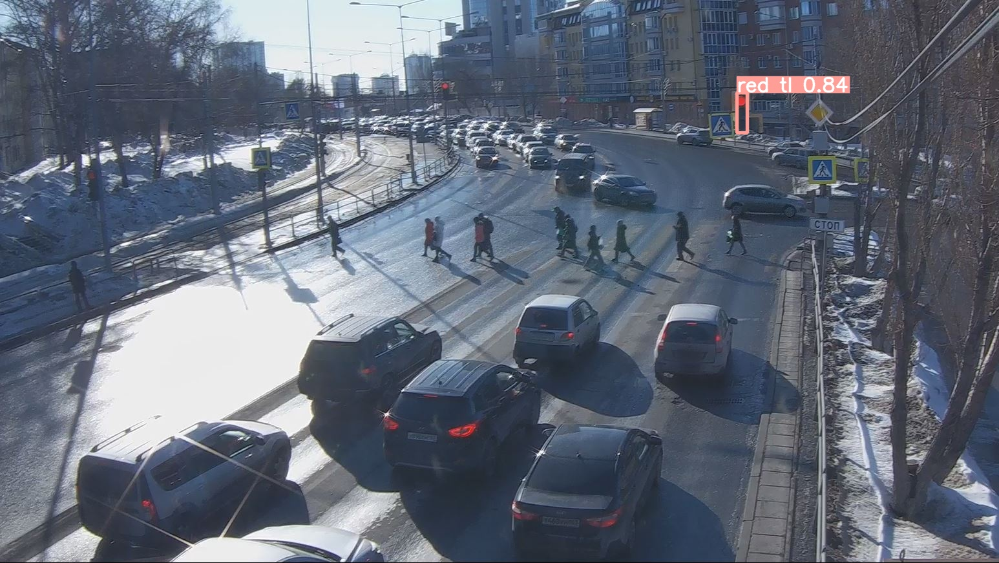

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp9/23.JPG', width=600)

# Третий цикл обучения. **300 эпох**. 

In [ ]:
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 100 --data /content/yolov5/new_data_yaml --weights /content/best2d100ep.pt

train: weights=/content/best2d100ep.pt, cfg=, data=/content/yolov5/new_data_yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-73-gd51f9b2 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degre

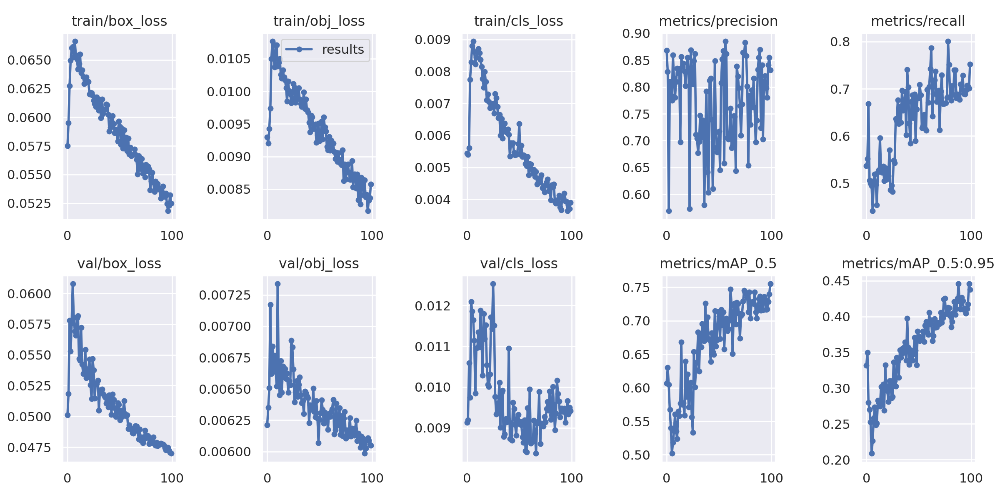

In [ ]:
display.Image('/content/yolov5/runs/train/exp2/results.png', width=1000)

# **Тестирование** модели после 300 эпох 

In [ ]:
!python detect.py --weights /content/best3d100ep.pt --conf 0.4 --save-txt --source /content/test/

detect: weights=['/content/best3d100ep.pt'], source=/content/test/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-95-gea72b84 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/4 /content/test/1.jpg: 448x640 2 green tls, Done. (0.019s)
image 2/4 /content/test/2.jpg: 448x640 Done. (0.015s)
image 3/4 /content/test/3.jpg: 480x640 1 red tl, Done. (0.019s)
image 4/4 /content/test/4.JPG: 448x640 1 red tl, Done. (0.015s)
Speed: 0.4ms pre-process, 17.1ms inference, 0.8ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp3
3 labels saved t

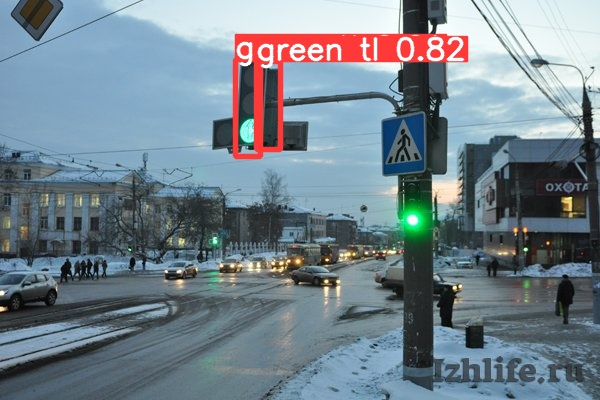

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp3/1.jpg', width=600)

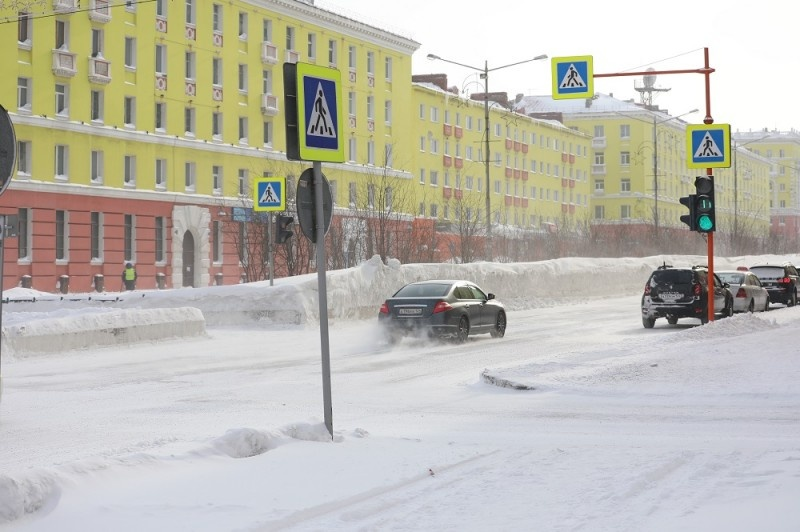

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp3/2.jpg', width=600)

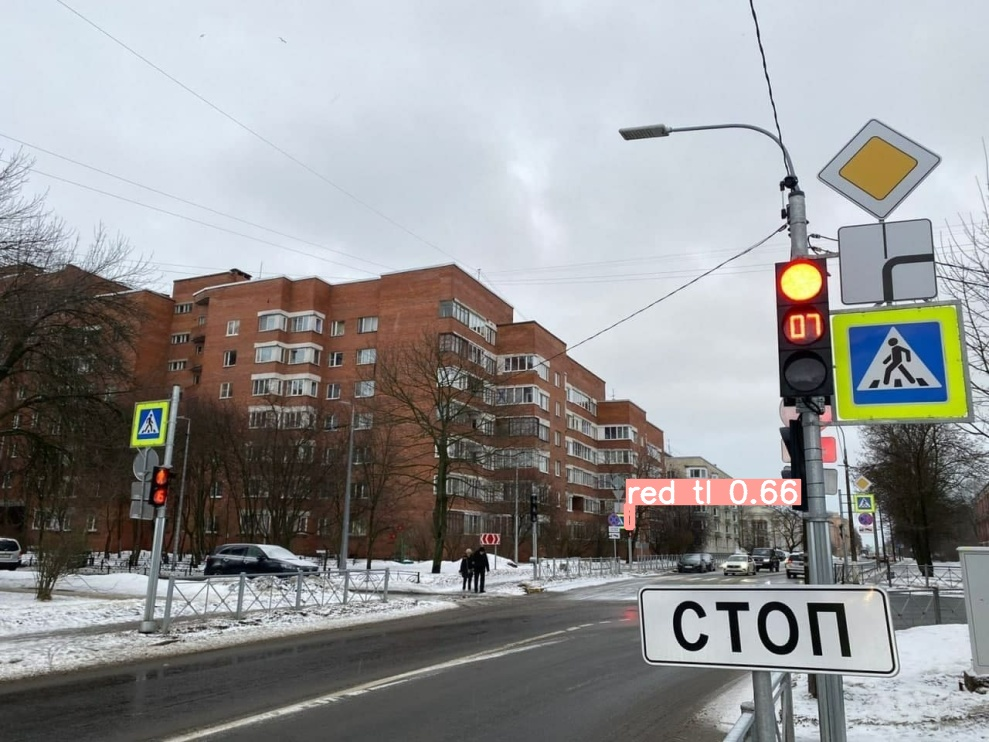

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp3/3.jpg', width=600)

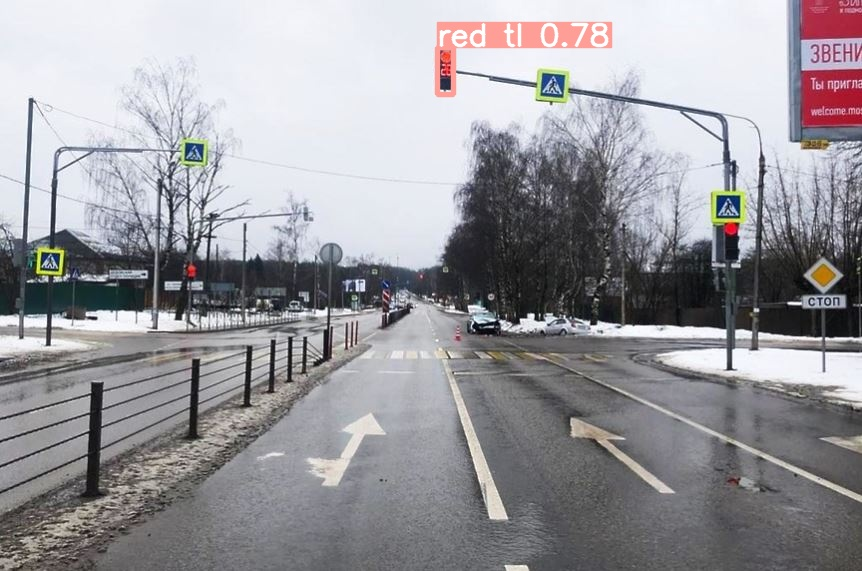

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp3/4.JPG', width=600)

In [ ]:
!python detect.py --weights /content/best3d100ep.pt --conf 0.4 --save-txt --source /content/23.JPG

detect: weights=['/content/best3d100ep.pt'], source=/content/23.JPG, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-95-gea72b84 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/23.JPG: 384x640 Done. (0.017s)
Speed: 0.4ms pre-process, 17.3ms inference, 0.3ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp4
0 labels saved to runs/detect/exp4/labels


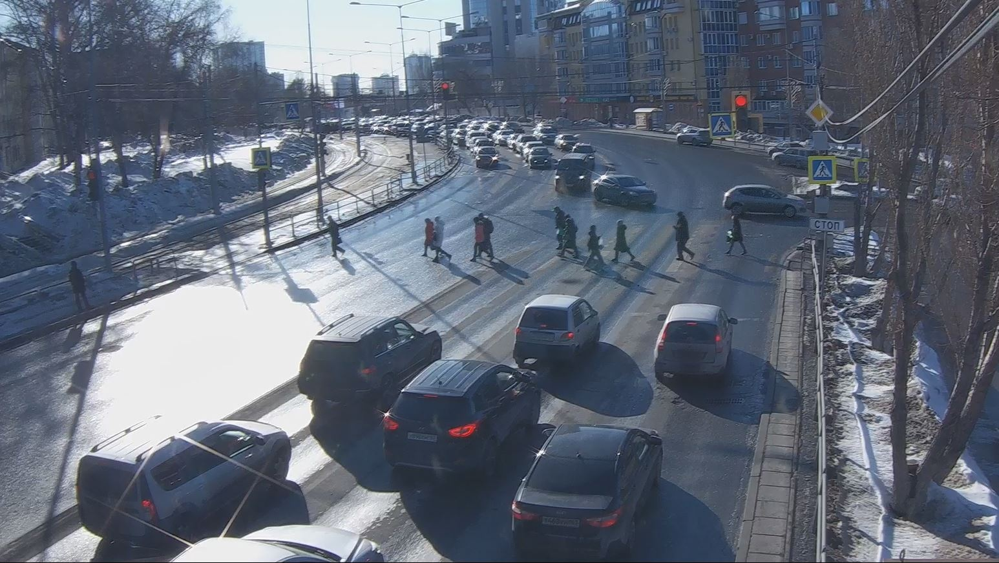

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp4/23.JPG', width=600)

# ОБУЧЕНИЕ НА НОВОМ ДАТАСЕТЕ  
Четвертый цикл обучение на 100 эпох (**400!**)

Создаем новый файл под новый датасет 

In [ ]:
with open('second_data_yaml', 'w+') as file:
  file.write(
      """
      train: /content/drive/My Drive/AIData/traffic lights v2/train/images
      val: /content/drive/My Drive/AIData/traffic lights v2/valid/images

      nc: 4
      names: ['green tl', 'red tl', 'unknown tl', 'yellow tl']
      """
  )

In [ ]:
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 100 --data /content/yolov5/second_data_yaml --weights /content/best3d100ep.pt

train: weights=/content/best3d100ep.pt, cfg=, data=/content/yolov5/new_data_yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-76-gc94736a torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degre

# Результаты обучения после 400 эпох (+ 100 эпох на новом датасете) 

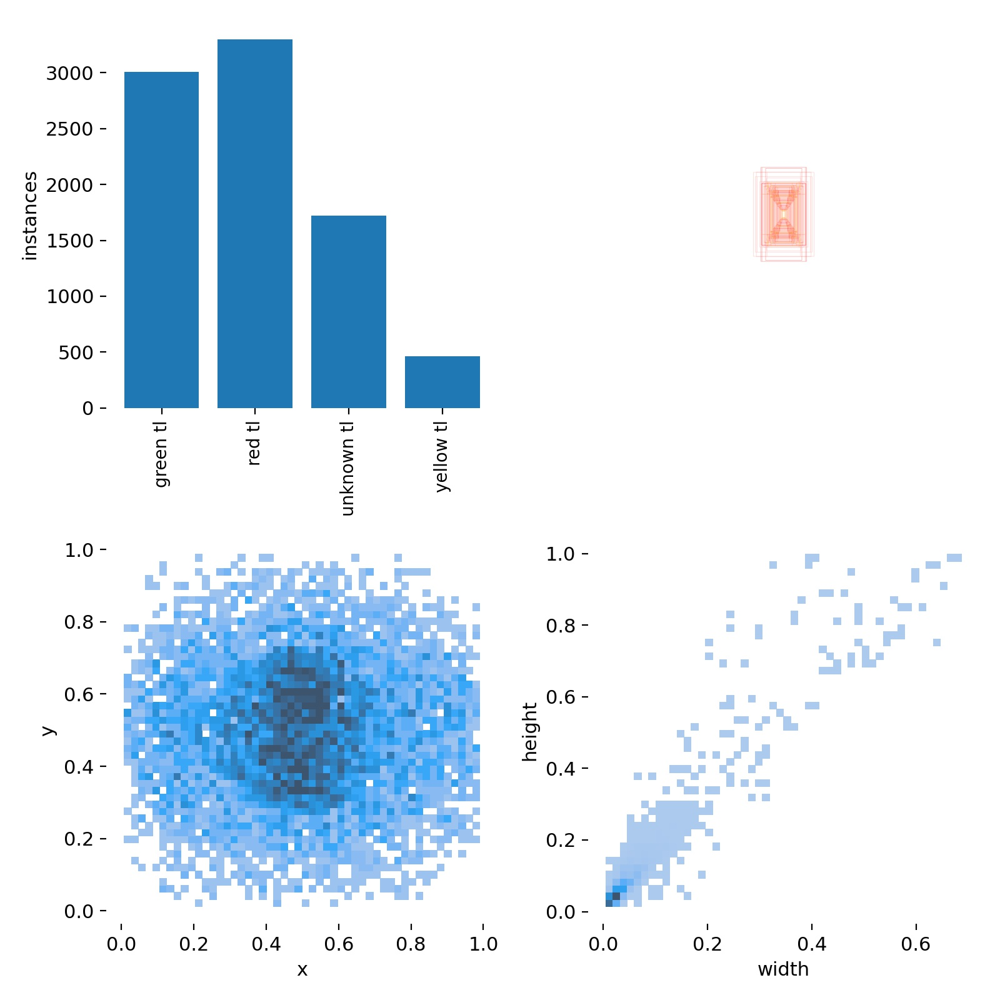

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/labels.jpg', width=700)

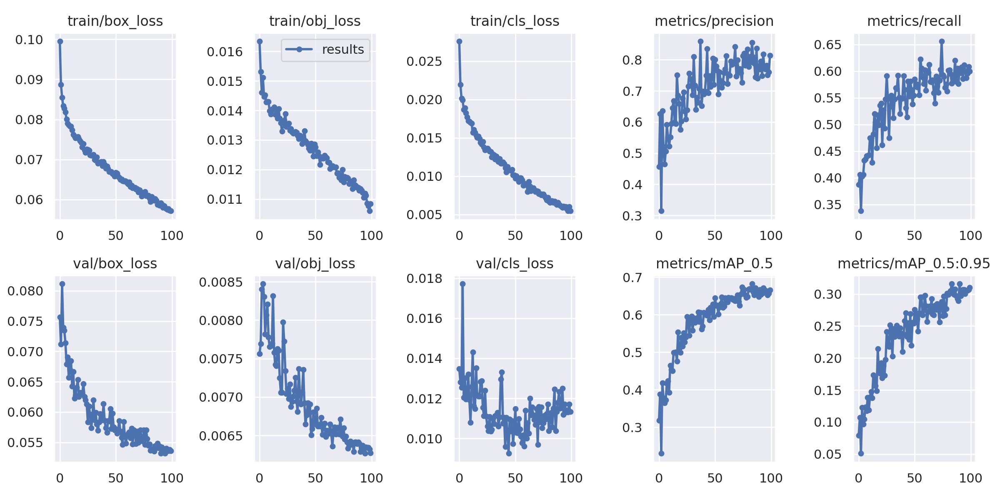

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/results.png', width=1000)

**ПЕРВЫЙ БАТЧ**


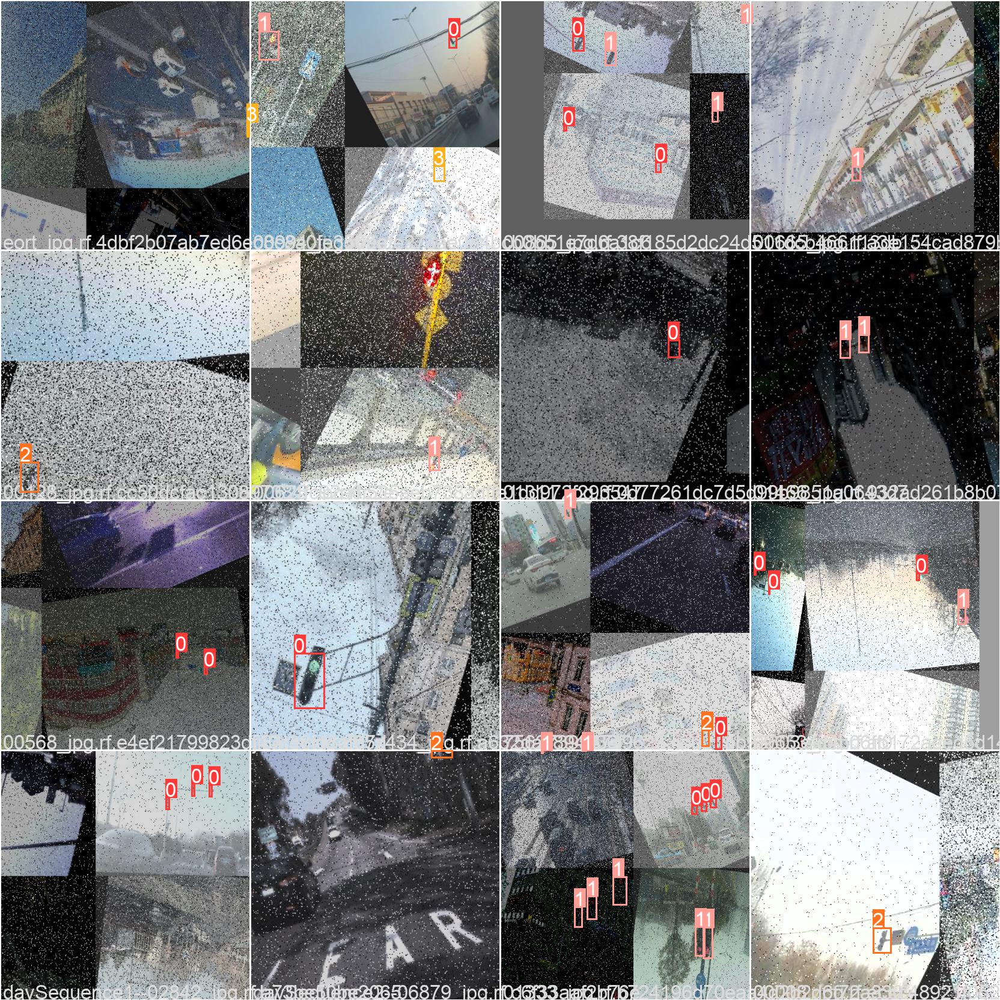

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/train_batch0.jpg', width=1000)

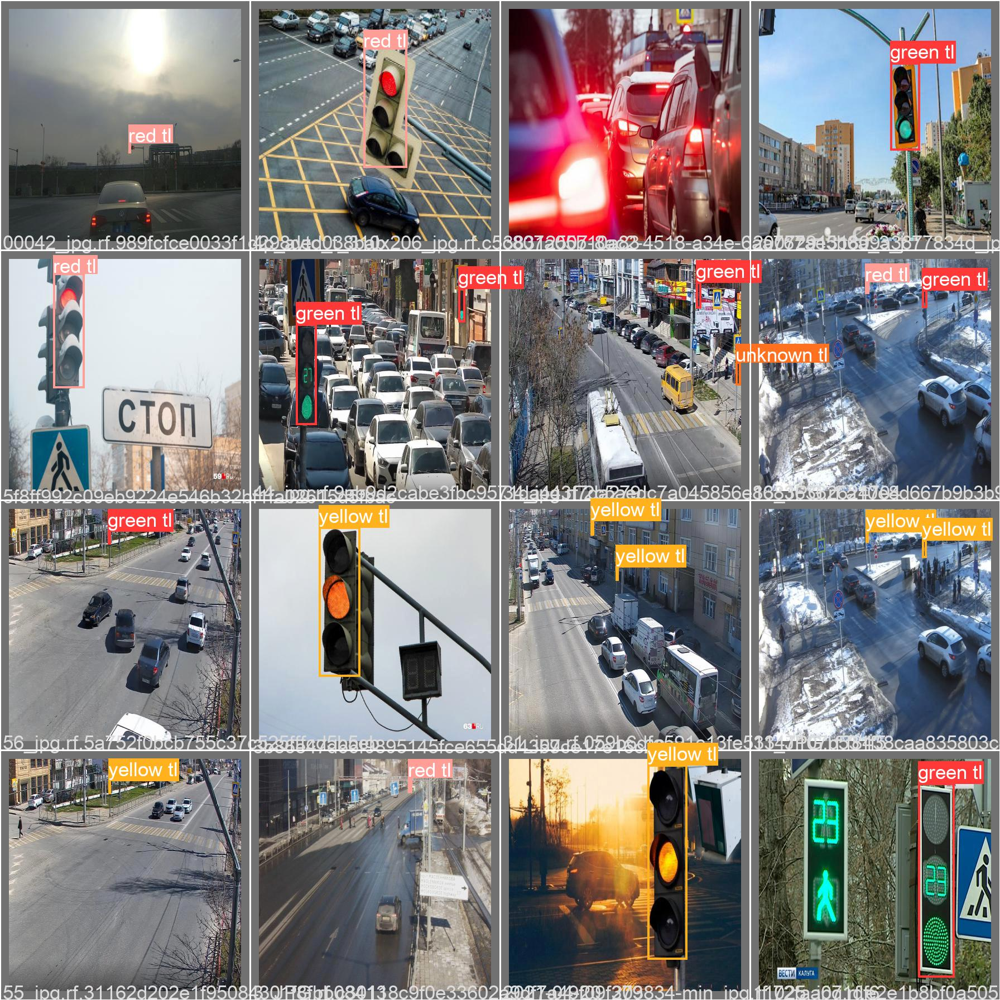

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/val_batch0_labels.jpg', width=1000)

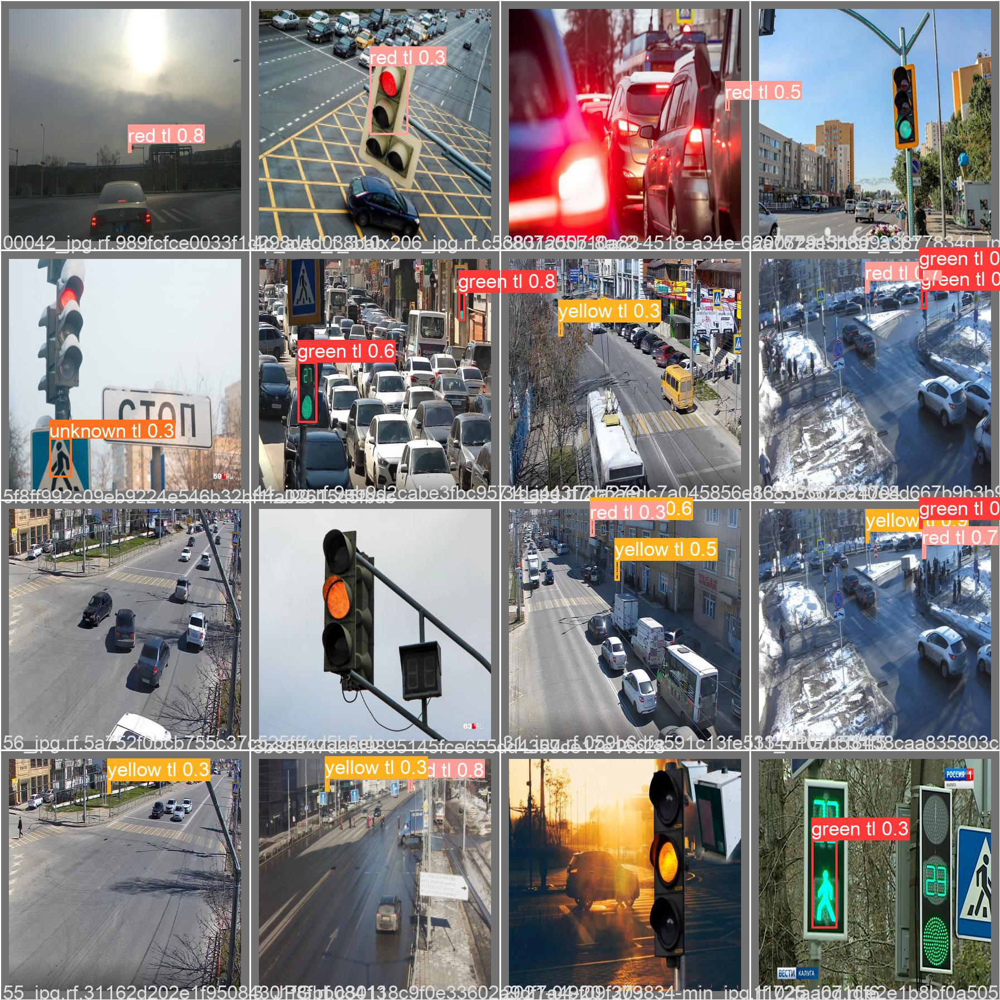

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/val_batch0_pred.jpg', width=1000)

**ВТОРОЙ БАТЧ**

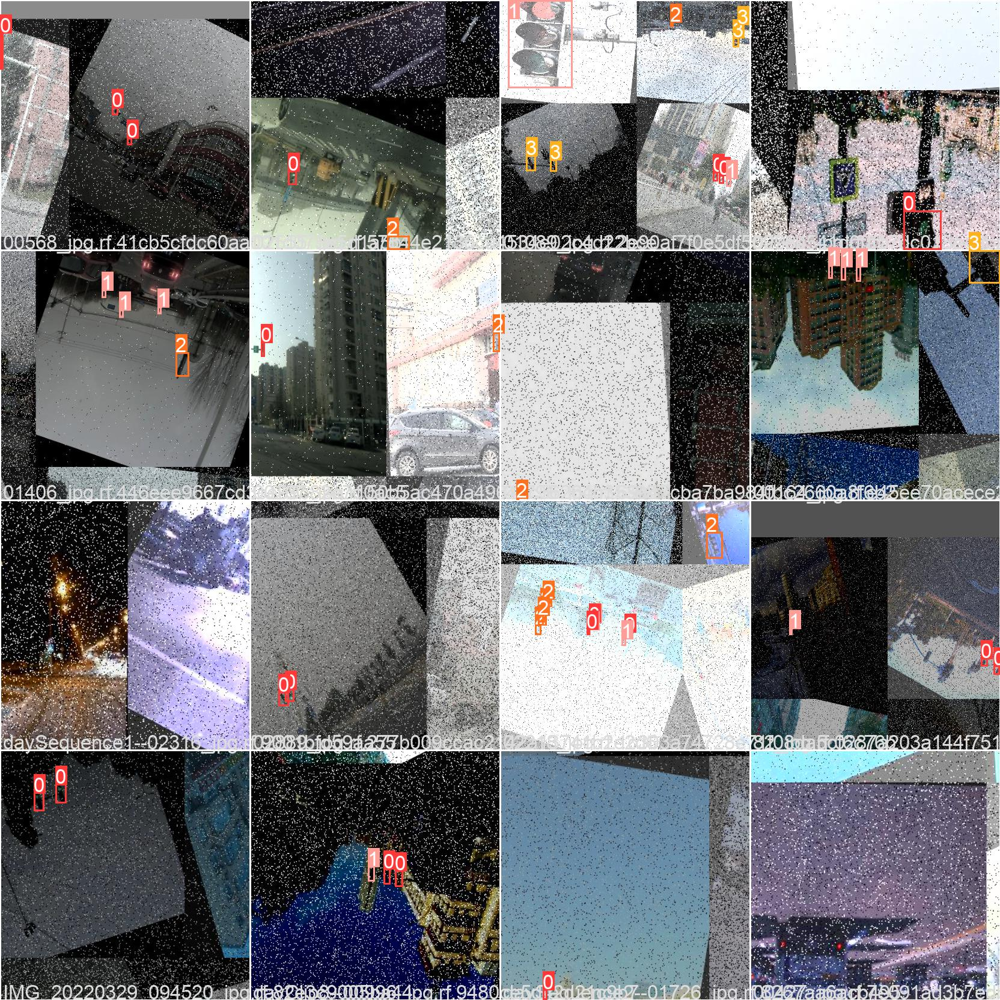

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/train_batch1.jpg', width=1000)

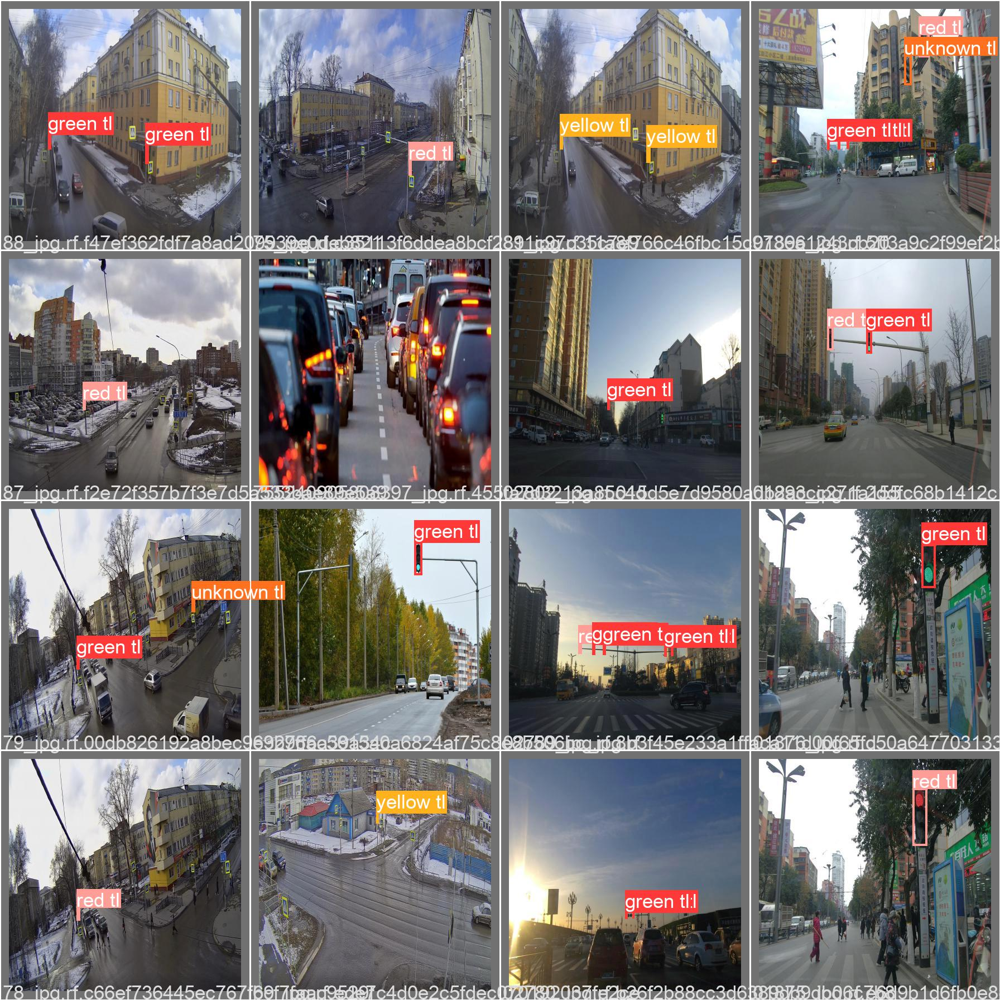

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/val_batch1_labels.jpg', width=1000)

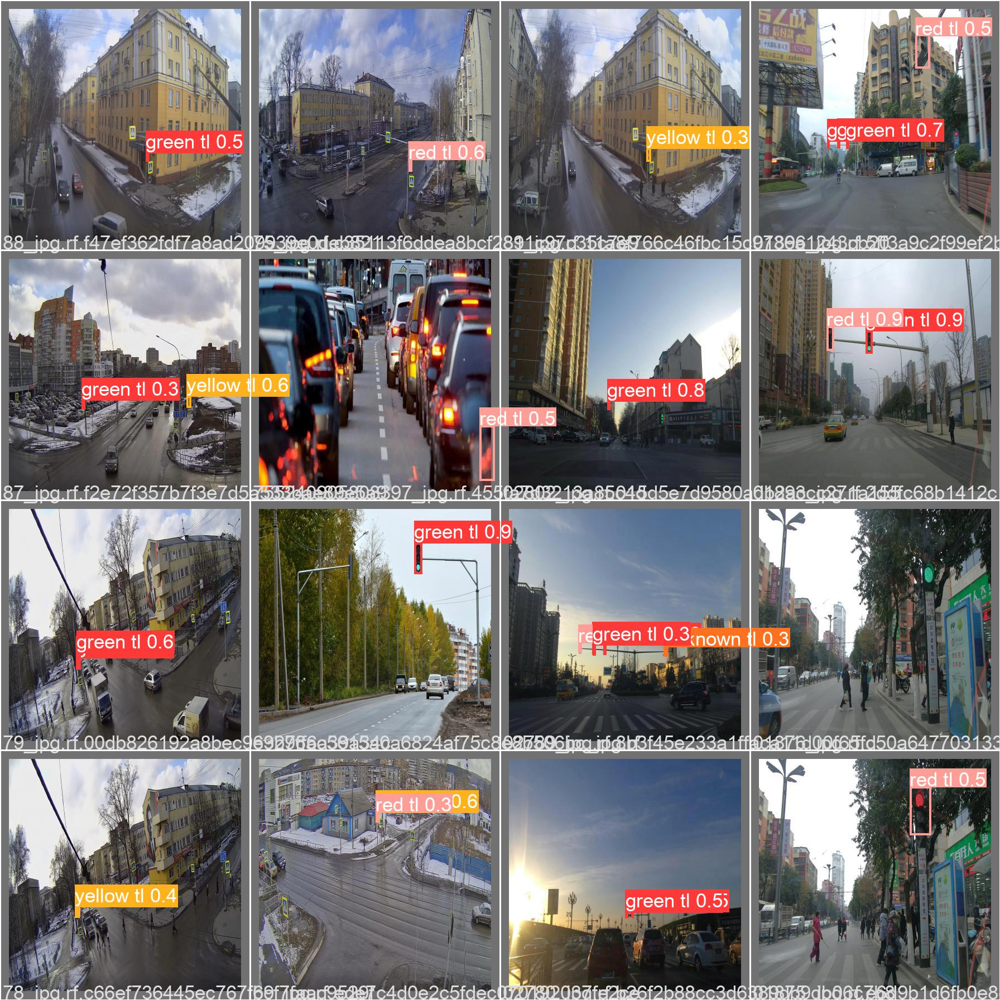

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/val_batch1_pred.jpg', width=1000)

**ТРЕТИЙ БАТЧ**

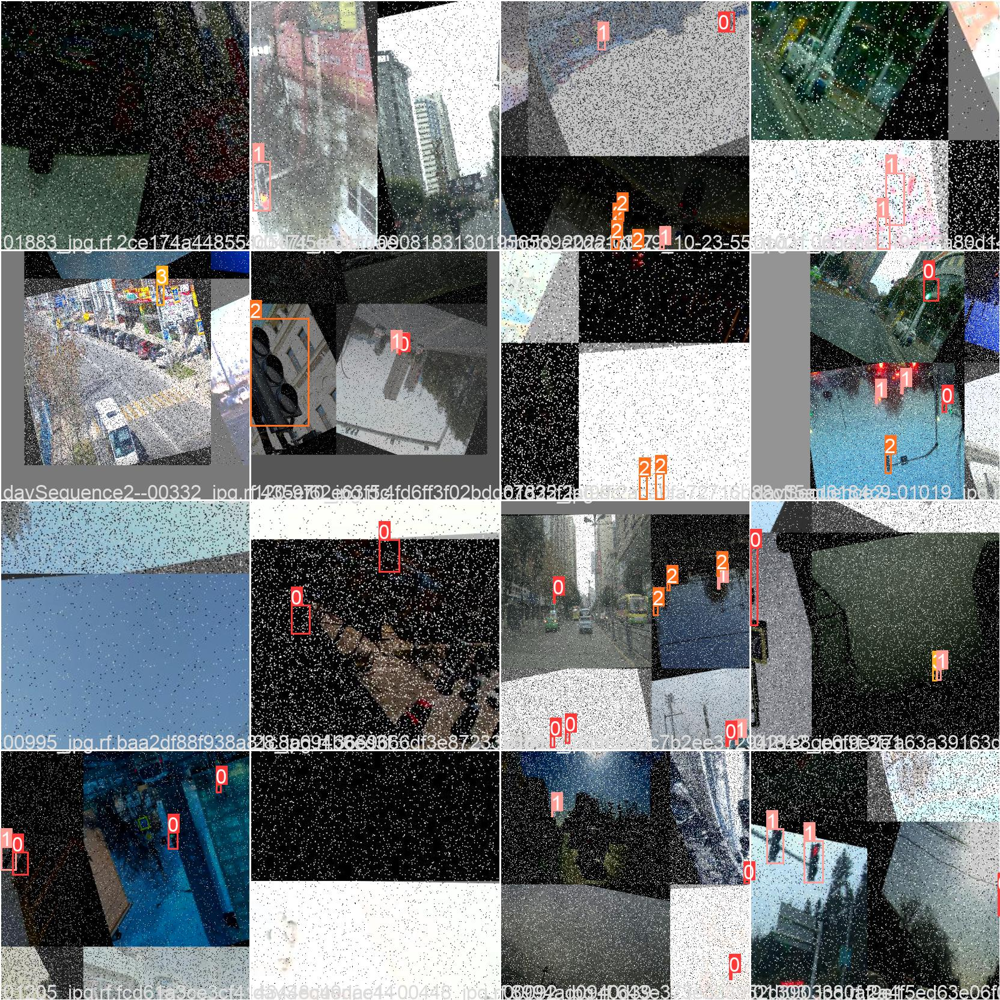

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/train_batch2.jpg', width=1000)

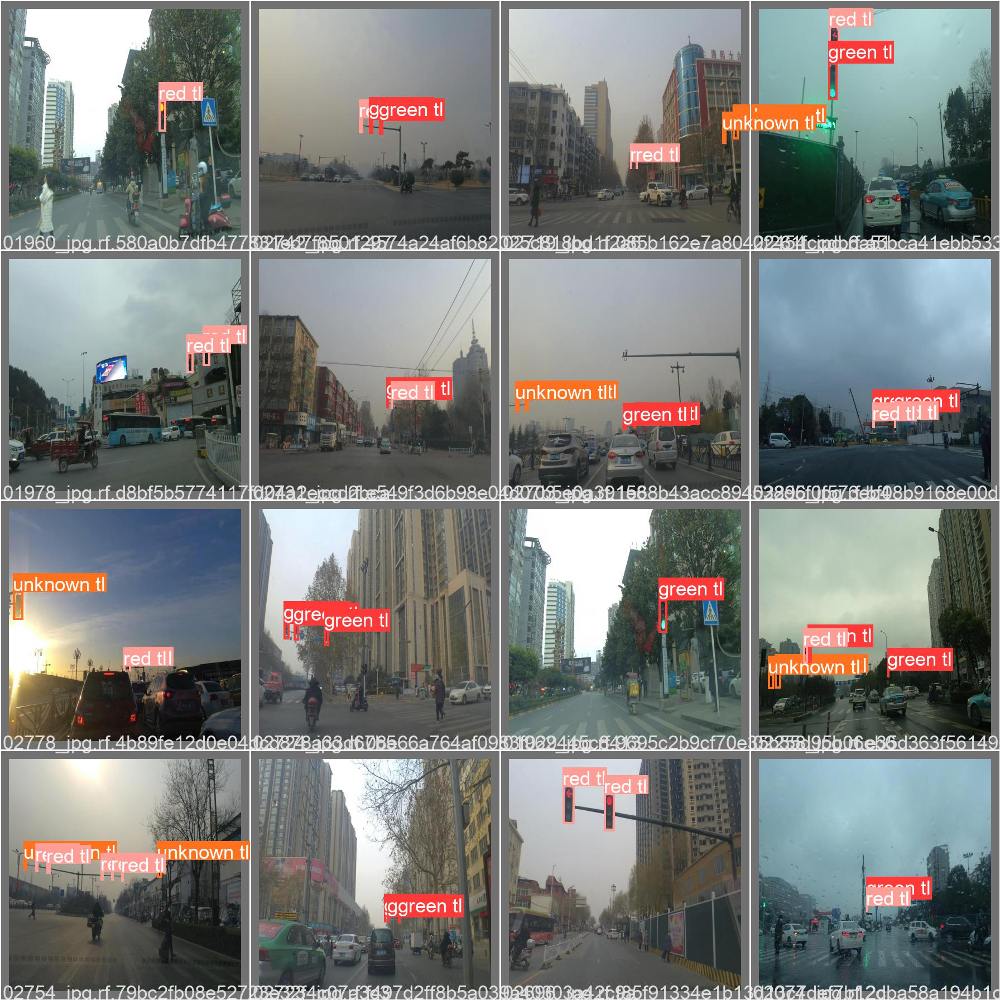

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/val_batch2_labels.jpg', width=1000)

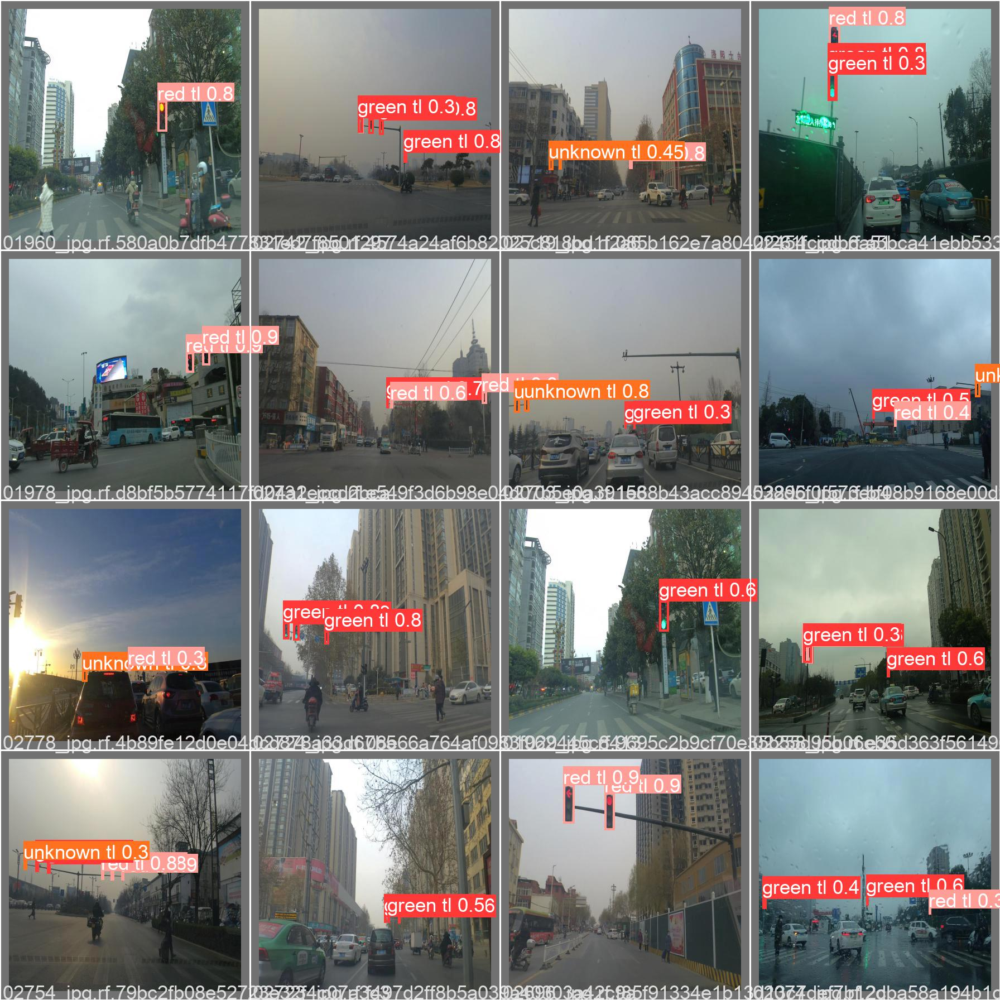

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/val_batch2_pred.jpg', width=1000)

# Тестируем после 400 эпох

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/1.jpg

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/1.jpg, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-76-gc94736a torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/1.jpg: 288x416 2 green tls, Done. (0.028s)
Speed: 0.4ms pre-process, 27.7ms inference, 1.8ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp2
1 labels saved to runs/detect/exp2/labels


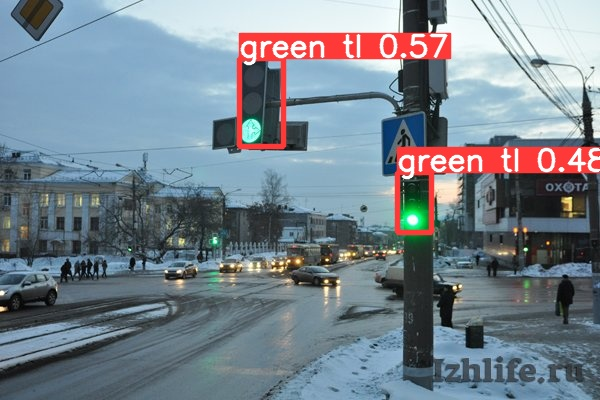

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp2/1.jpg', width=600)

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --conf 0.4 --save-txt --source /content/2.jpg

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/2.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-76-gc94736a torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/2.jpg: 448x640 1 green tl, Done. (0.030s)
Speed: 0.8ms pre-process, 30.1ms inference, 3.0ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp3
1 labels saved to runs/detect/exp3/labels


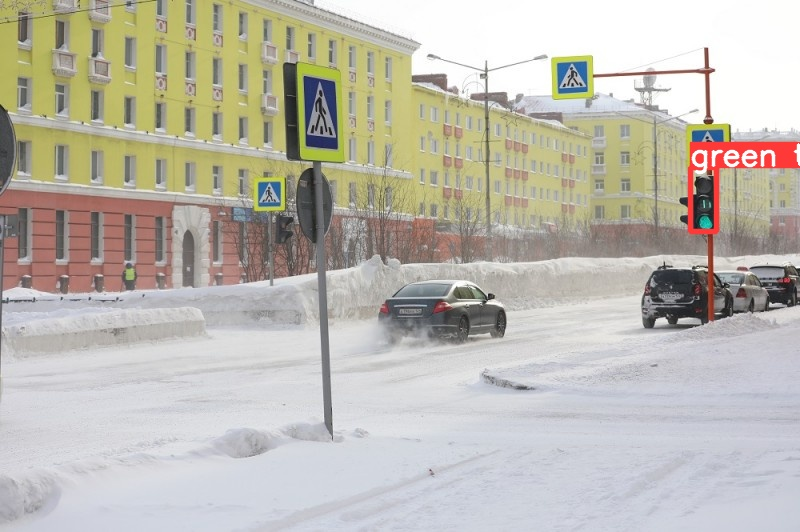

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp3/2.jpg', width=600)

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/3.jpg

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/3.jpg, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-76-gc94736a torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/3.jpg: 320x416 1 red tl, Done. (0.028s)
Speed: 0.4ms pre-process, 28.1ms inference, 1.6ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp4
1 labels saved to runs/detect/exp4/labels


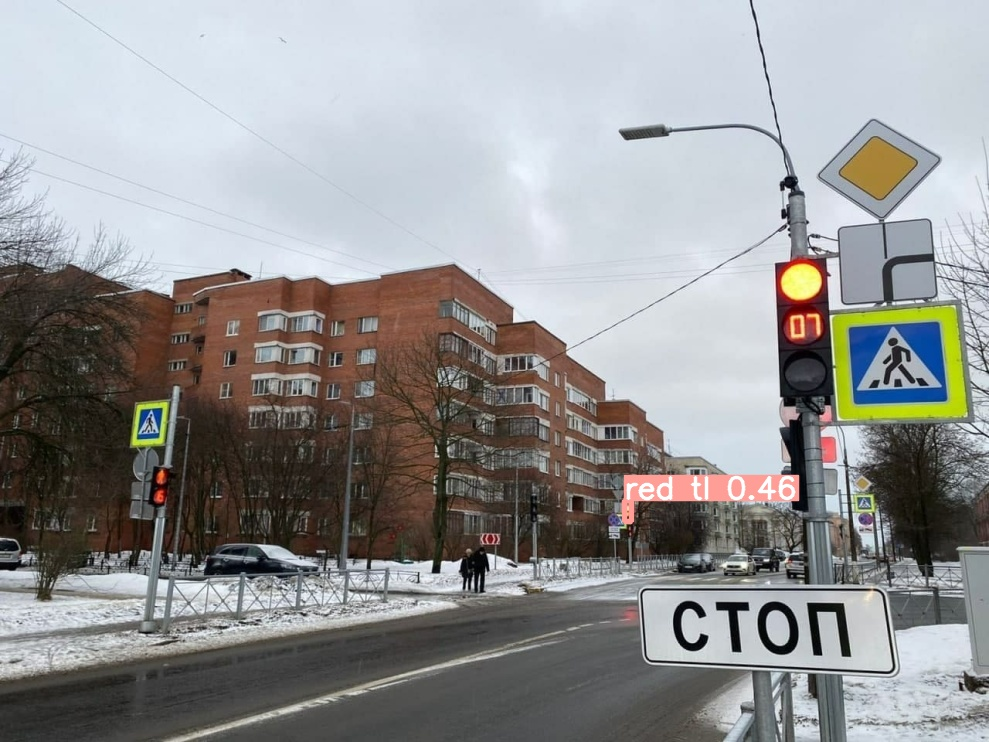

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp4/3.jpg', width=600)

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/5.jpg

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/5.jpg, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-76-gc94736a torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/5.jpg: 416x416 Done. (0.030s)
Speed: 0.5ms pre-process, 30.4ms inference, 0.5ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp5
0 labels saved to runs/detect/exp5/labels


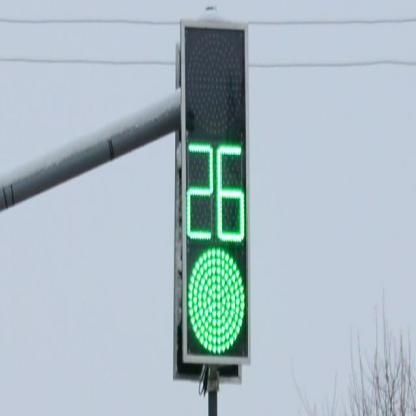

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp5/5.jpg', width=600)

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/6.jpg

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/6.jpg, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-76-gc94736a torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/6.jpg: 416x416 Done. (0.030s)
Speed: 0.5ms pre-process, 30.4ms inference, 0.4ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp6
0 labels saved to runs/detect/exp6/labels


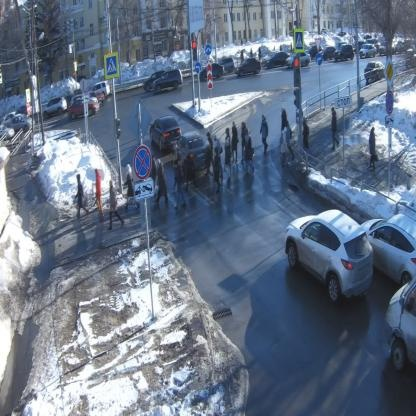

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp6/6.jpg', width=600)

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/testin

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/testin, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-76-gc94736a torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/4 /content/testin/10.jpg: 416x416 1 green tl, 2 red tls, Done. (0.030s)
image 2/4 /content/testin/7.jpg: 416x416 1 green tl, Done. (0.030s)
image 3/4 /content/testin/8.jpg: 416x416 2 red tls, Done. (0.030s)
image 4/4 /content/testin/9.jpg: 416x416 2 green tls, Done. (0.030s)
Speed: 0.4ms pre-process, 30.3ms inference, 1.9ms NMS per image at shape (1, 3, 

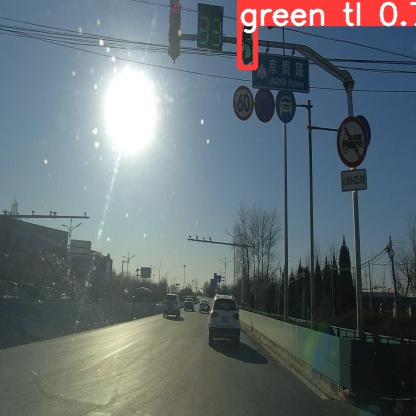

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp7/7.jpg', width=600)

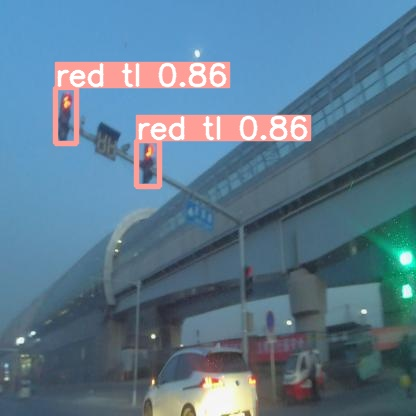

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp7/8.jpg', width=600)

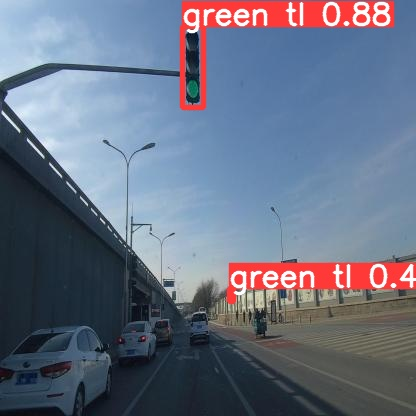

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp7/9.jpg', width=600)

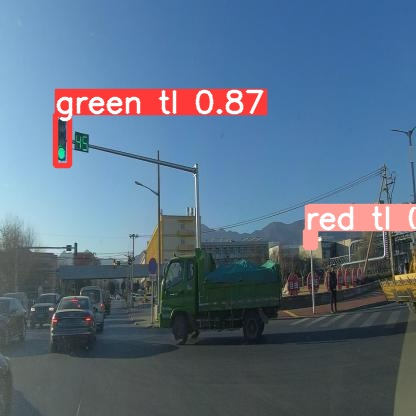

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp7/10.jpg', width=600)

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/11.jpg

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/11.jpg, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-76-gc94736a torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/11.jpg: 416x416 1 red tl, Done. (0.030s)
Speed: 0.4ms pre-process, 30.3ms inference, 2.0ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp8
1 labels saved to runs/detect/exp8/labels


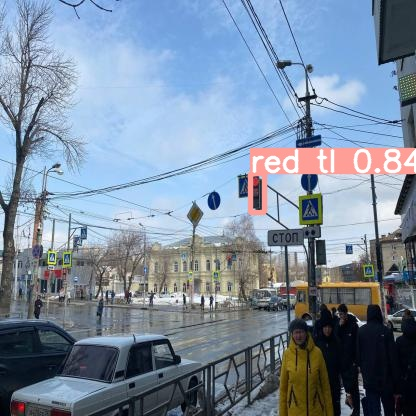

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp8/11.jpg', width=600)

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/12.jpg

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/12.jpg, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-76-gc94736a torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/1 /content/12.jpg: 416x416 3 green tls, 1 red tl, Done. (0.031s)
Speed: 0.4ms pre-process, 30.5ms inference, 1.9ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp9
1 labels saved to runs/detect/exp9/labels


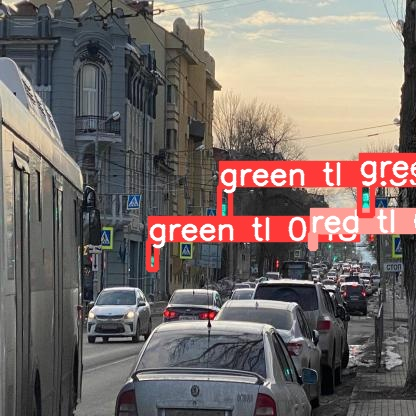

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp9/12.jpg', width=600)

# Пятый цикл обучения. **500 эпох**. 

In [ ]:
with open('second_data_yaml', 'w+') as file:
  file.write(
      """
      train: /content/drive/My Drive/AIData/traffic lights v2/train/images
      val: /content/drive/My Drive/AIData/traffic lights v2/valid/images

      nc: 4
      names: ['green tl', 'red tl', 'unknown tl', 'yellow tl']
      """
  )

In [ ]:
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 100 --data /content/yolov5/second_data_yaml --weights /content/best400ep.pt

train: weights=/content/best400ep.pt, cfg=, data=/content/yolov5/second_data_yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-82-g71621df torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degr

# Результаты обучения после 500 эпох 

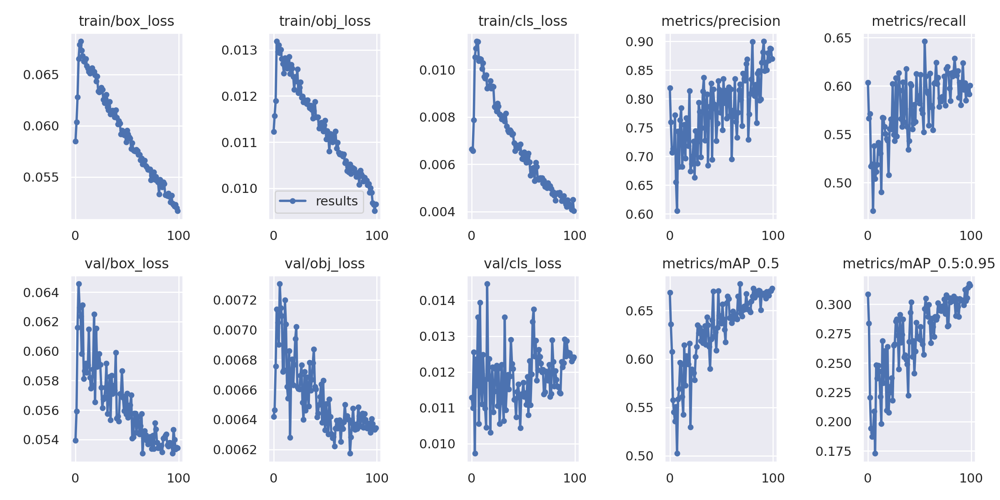

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/results.png', width=1000)

**ПЕРВЫЙ БАТЧ**


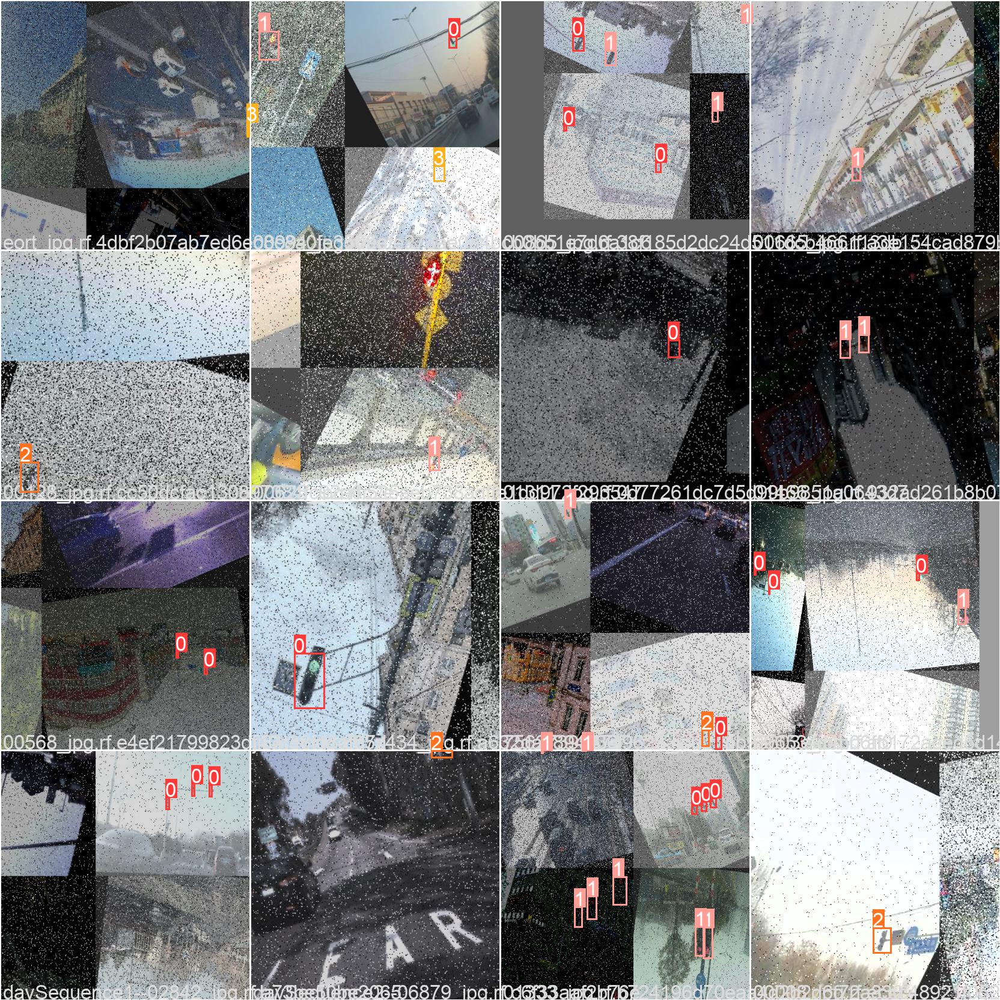

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/train_batch0.jpg', width=1000)

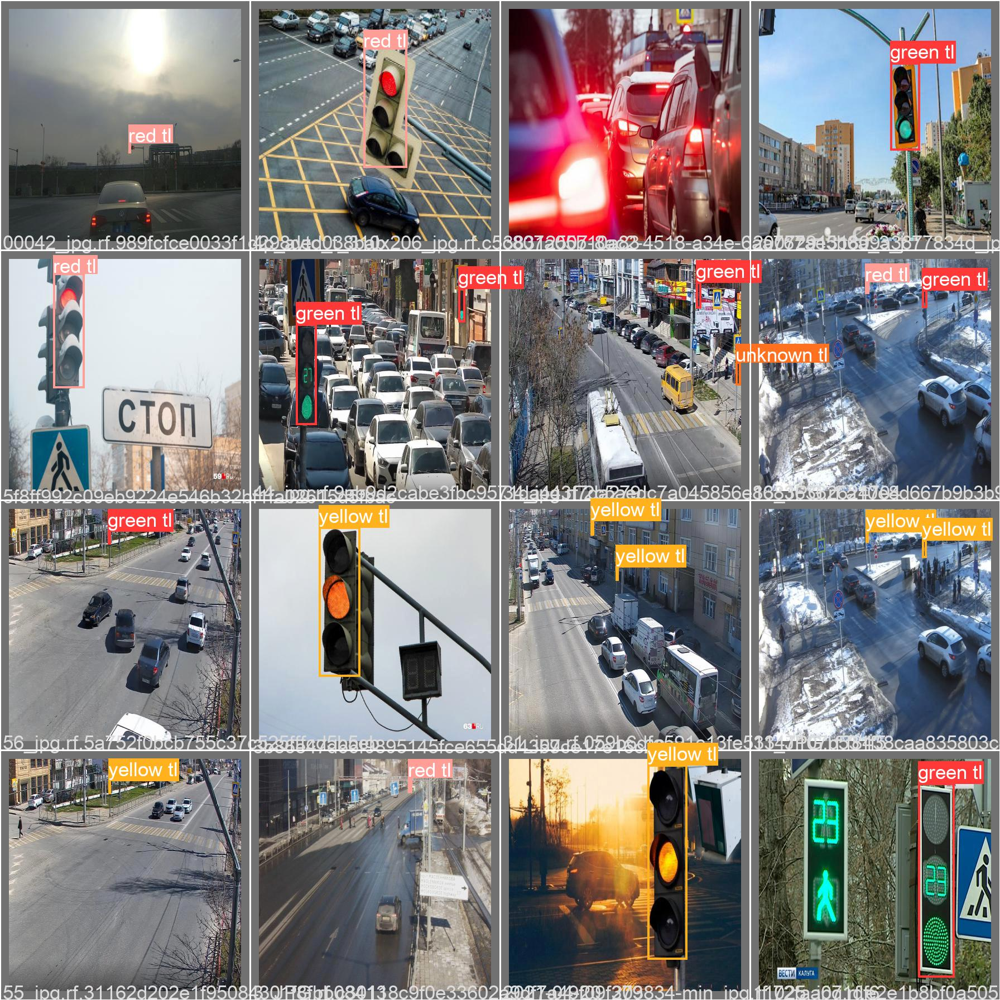

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/val_batch0_labels.jpg', width=1000)

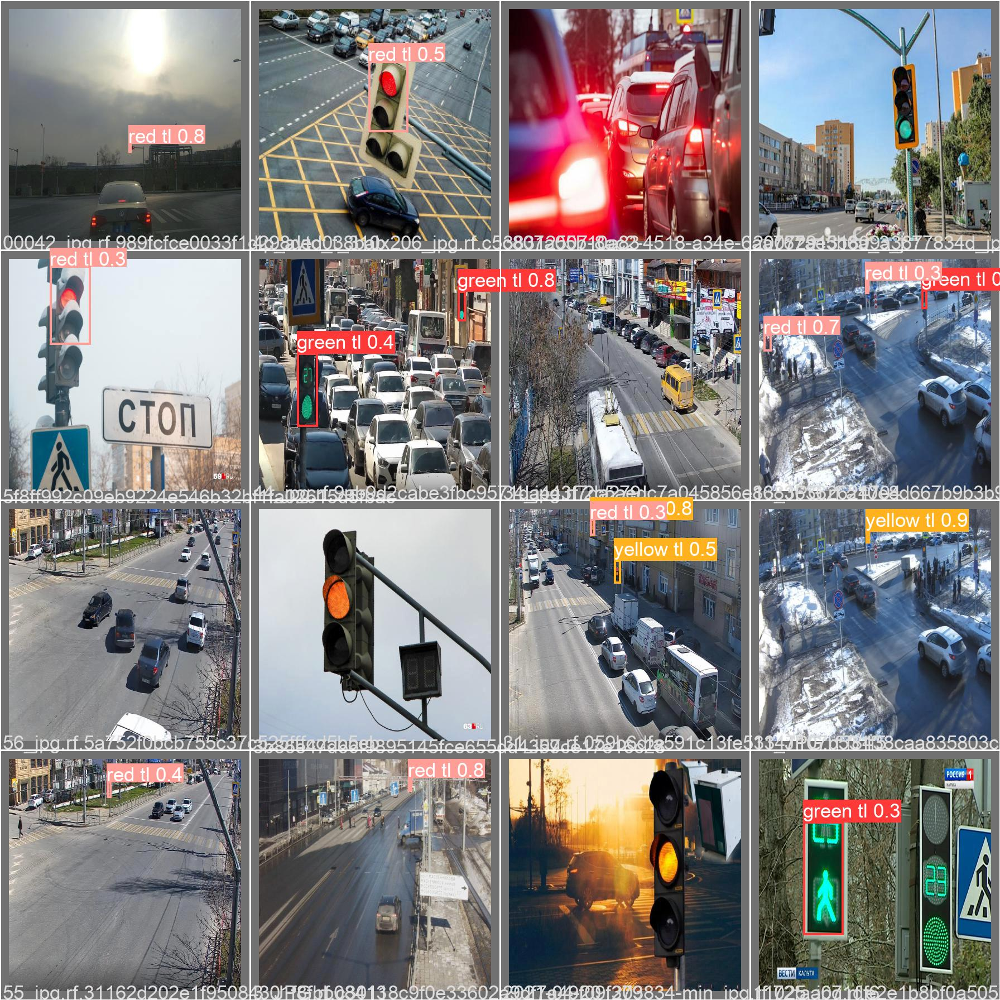

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/val_batch0_pred.jpg', width=1000)

**ВТОРОЙ БАТЧ**

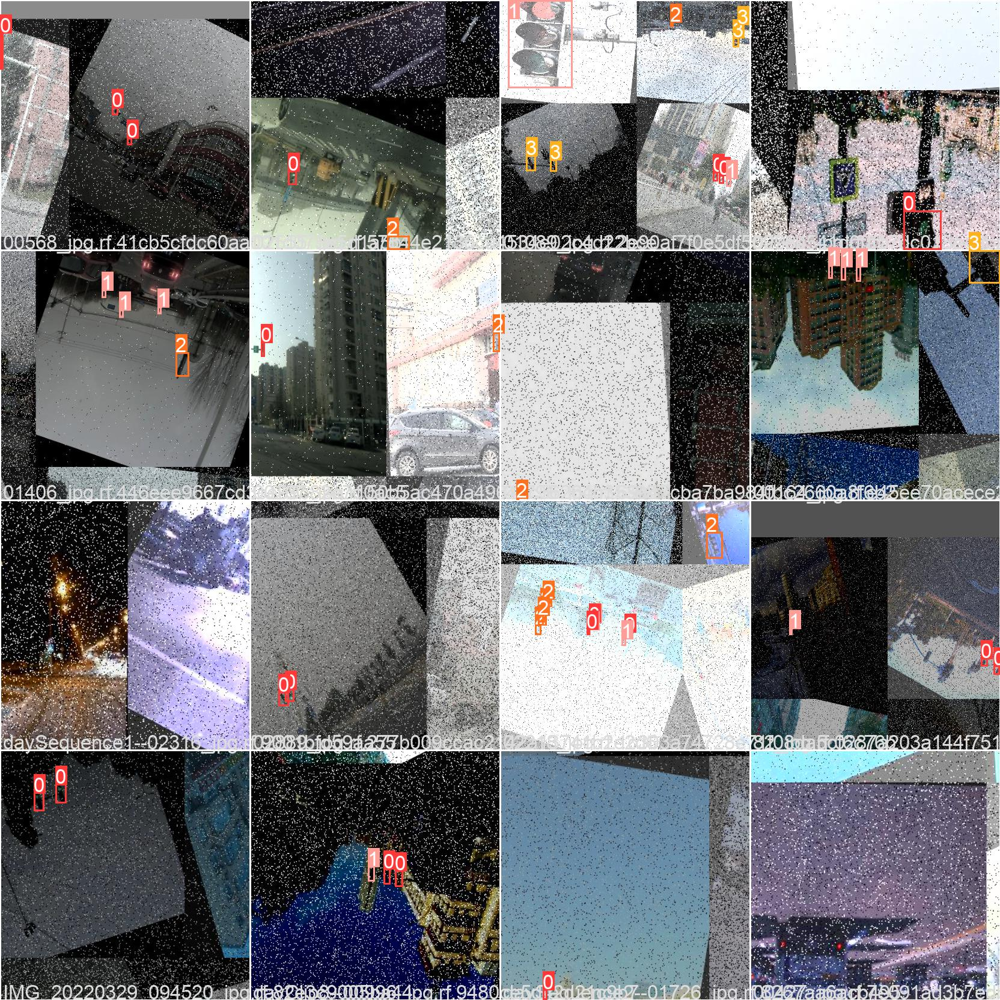

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/train_batch1.jpg', width=1000)

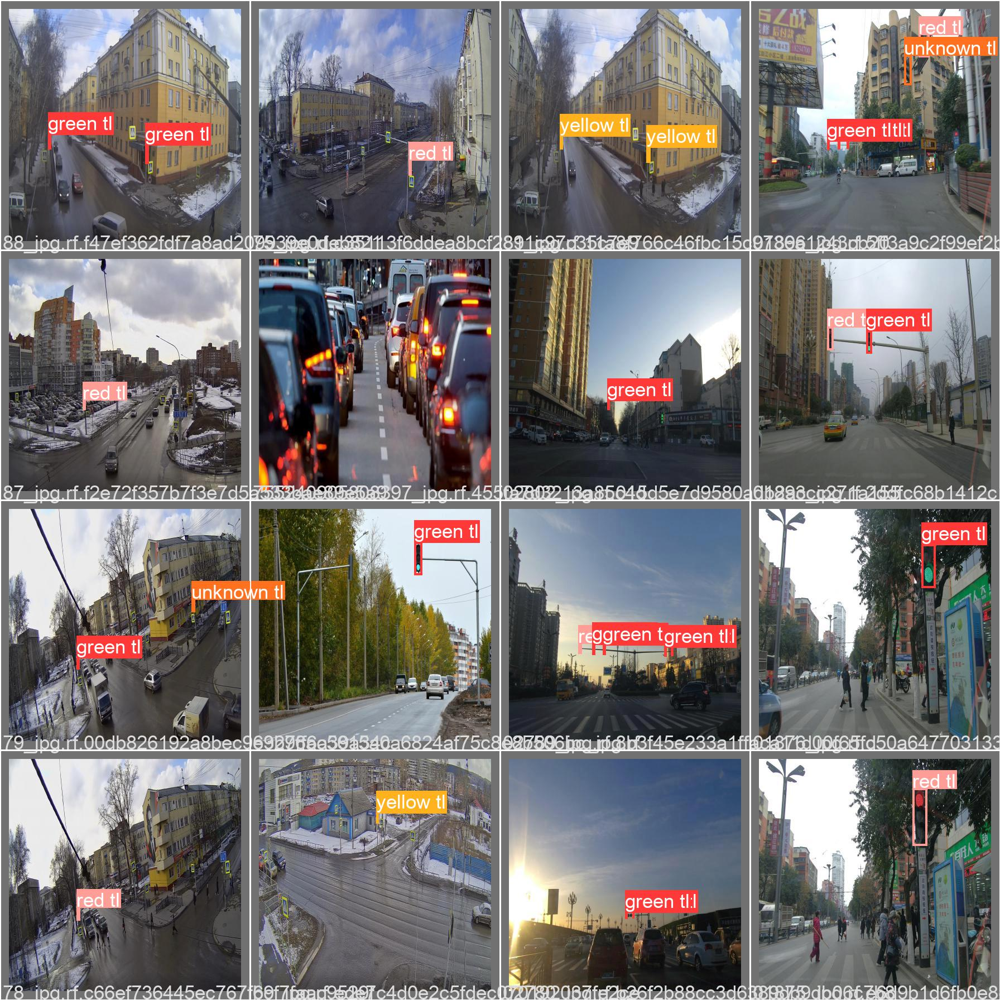

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/val_batch1_labels.jpg', width=1000)

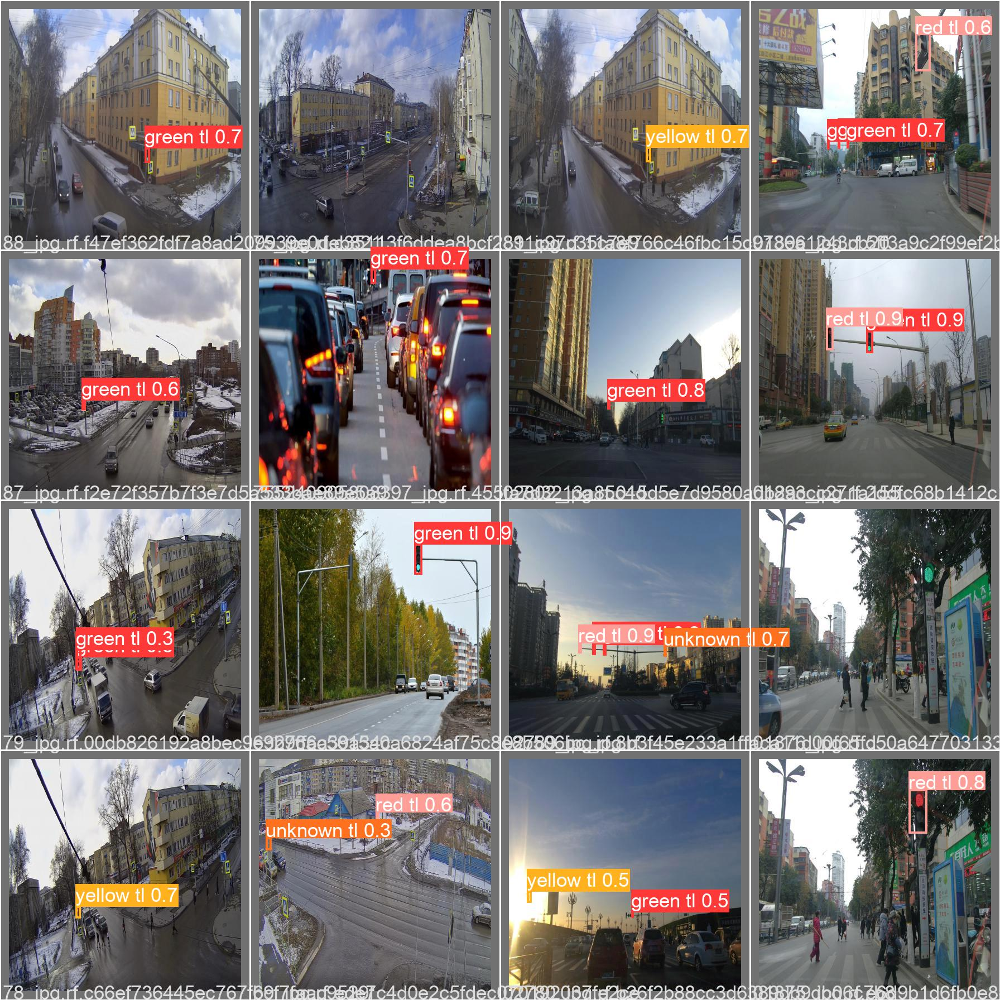

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/val_batch1_pred.jpg', width=1000)

**ТРЕТИЙ БАТЧ**

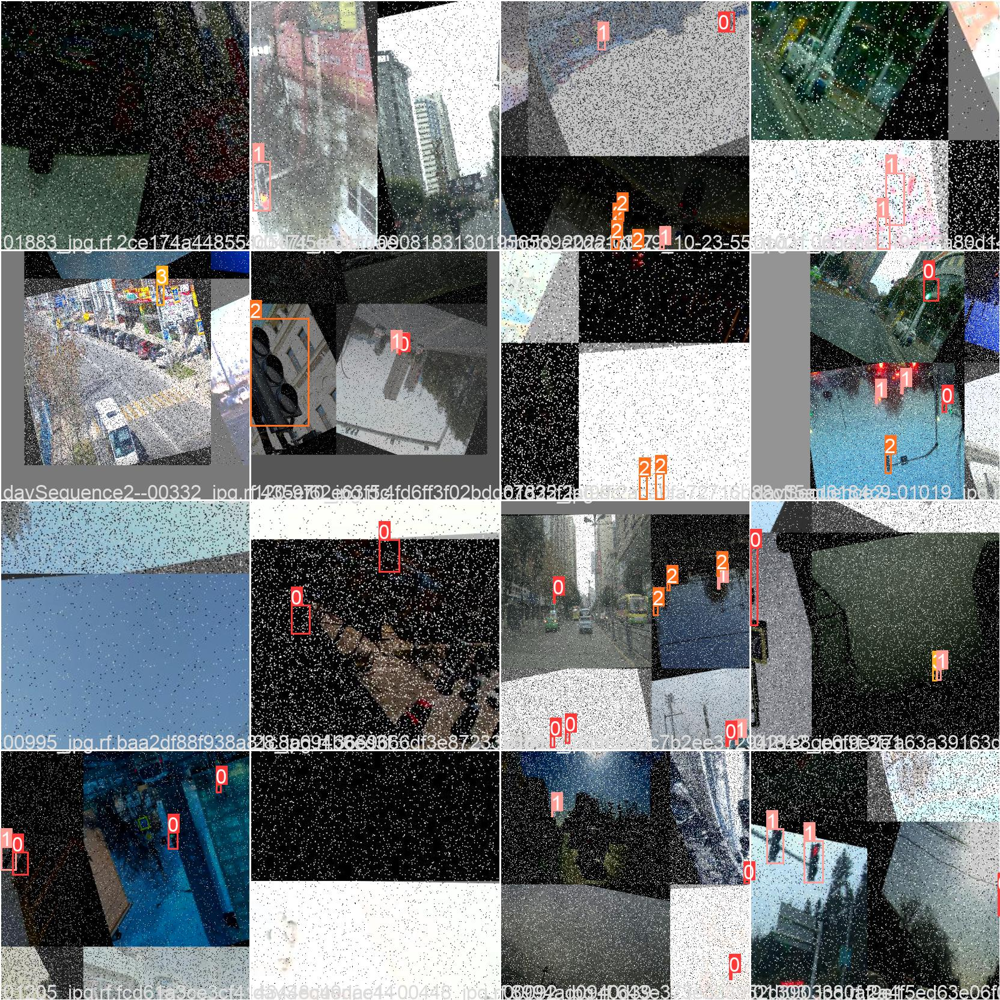

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/train_batch2.jpg', width=1000)

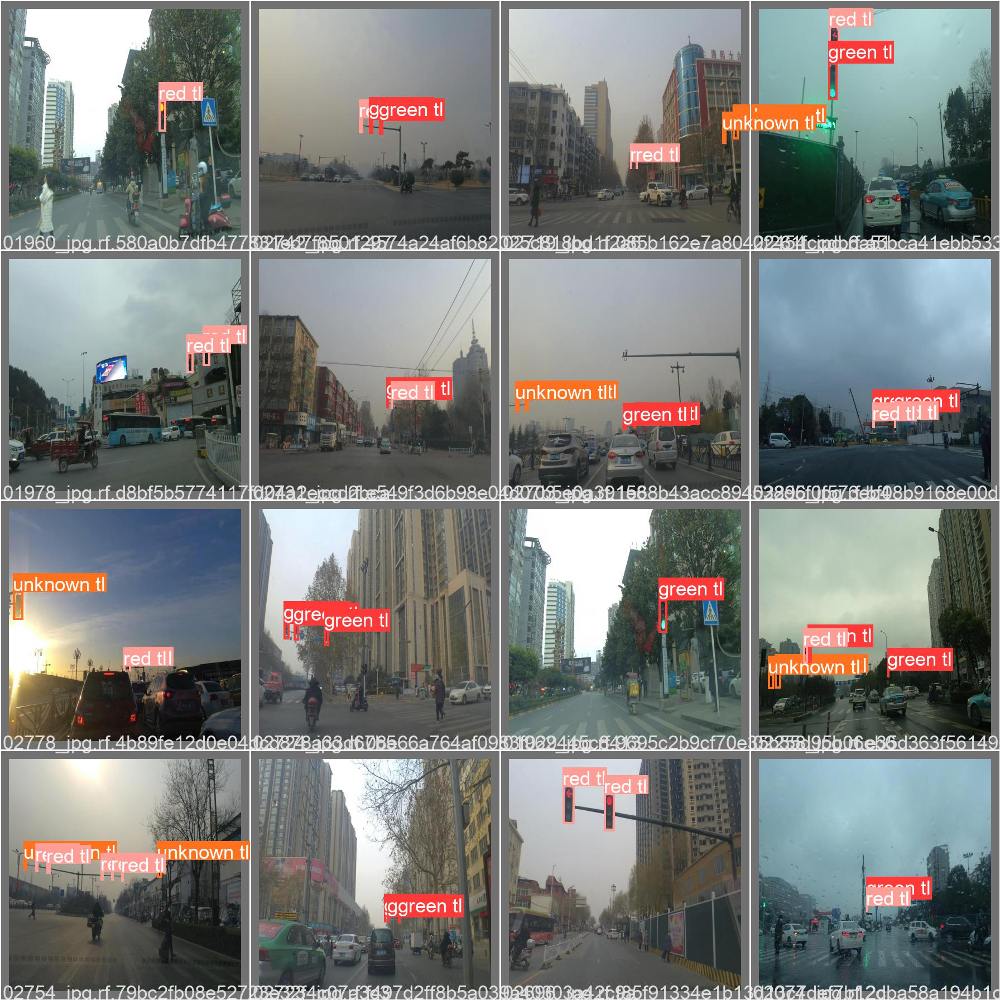

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/val_batch2_labels.jpg', width=1000)

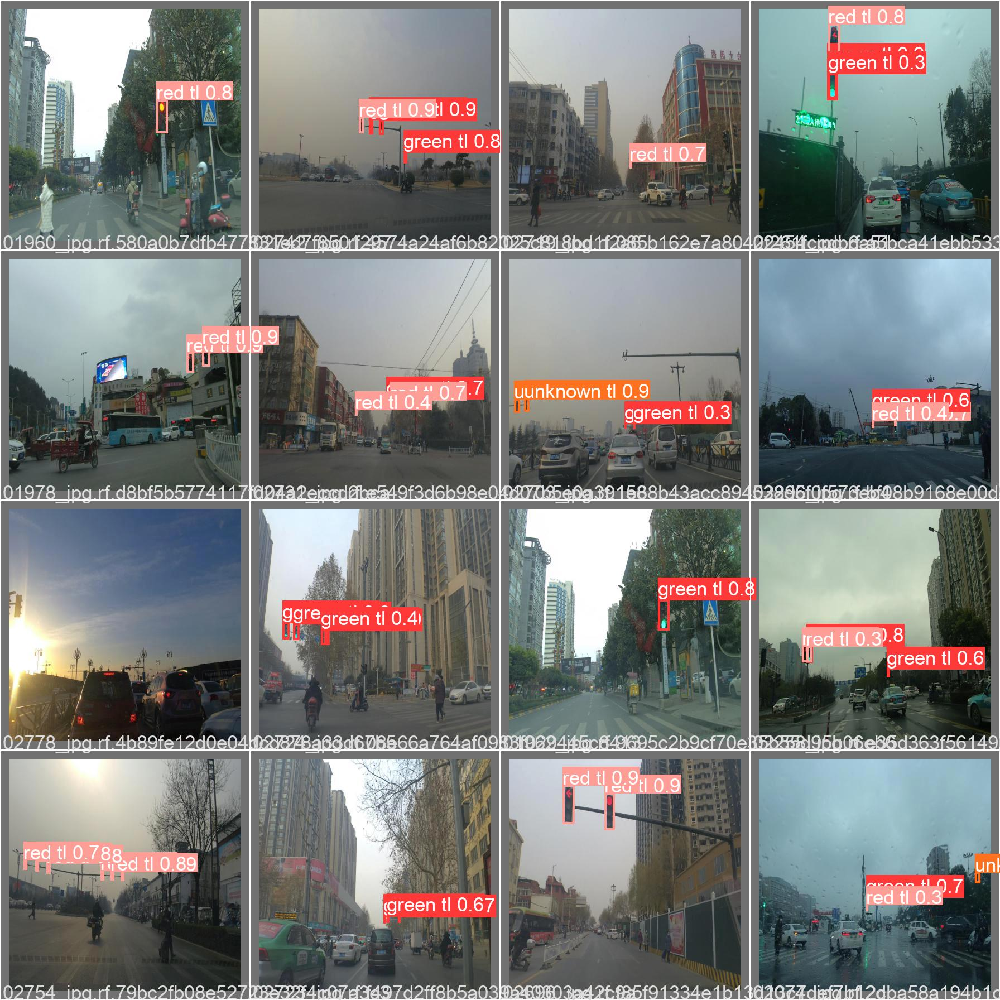

In [ ]:
display.Image(filename='/content/yolov5/runs/train/exp/val_batch2_pred.jpg', width=1000)

# Тестируем после 500 эпох

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 416 --conf 0.4 --save-txt --source /content/test

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/test, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-82-g71621df torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPs
image 1/12 /content/test/1.jpg: 288x416 2 green tls, Done. (0.028s)
image 2/12 /content/test/10.jpg: 416x416 1 green tl, 1 red tl, Done. (0.031s)
image 3/12 /content/test/11.jpg: 416x416 2 red tls, Done. (0.031s)
image 4/12 /content/test/12.jpg: 416x416 2 green tls, 1 red tl, Done. (0.031s)
image 5/12 /content/test/2.jpg: 288x416 1 green tl, Done. (0.028s)
image 6

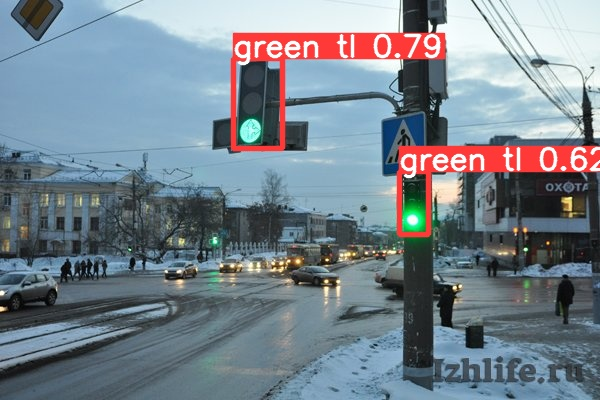

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp/1.jpg', width=600)

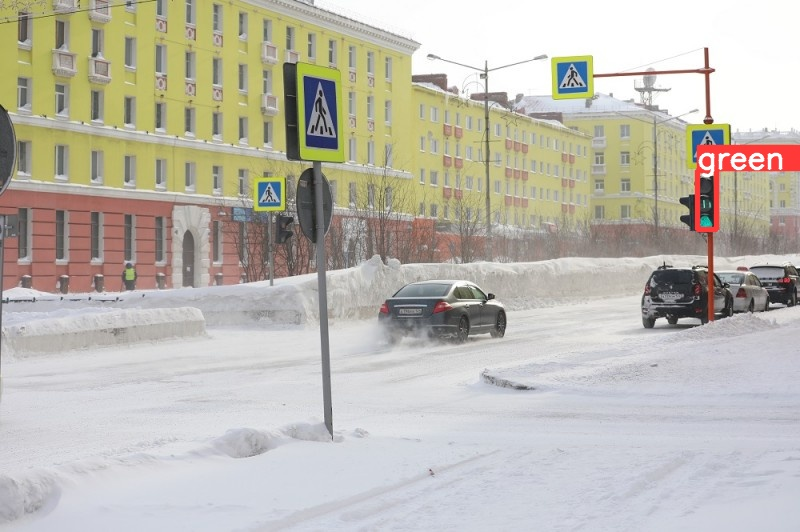

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp/2.jpg', width=600)

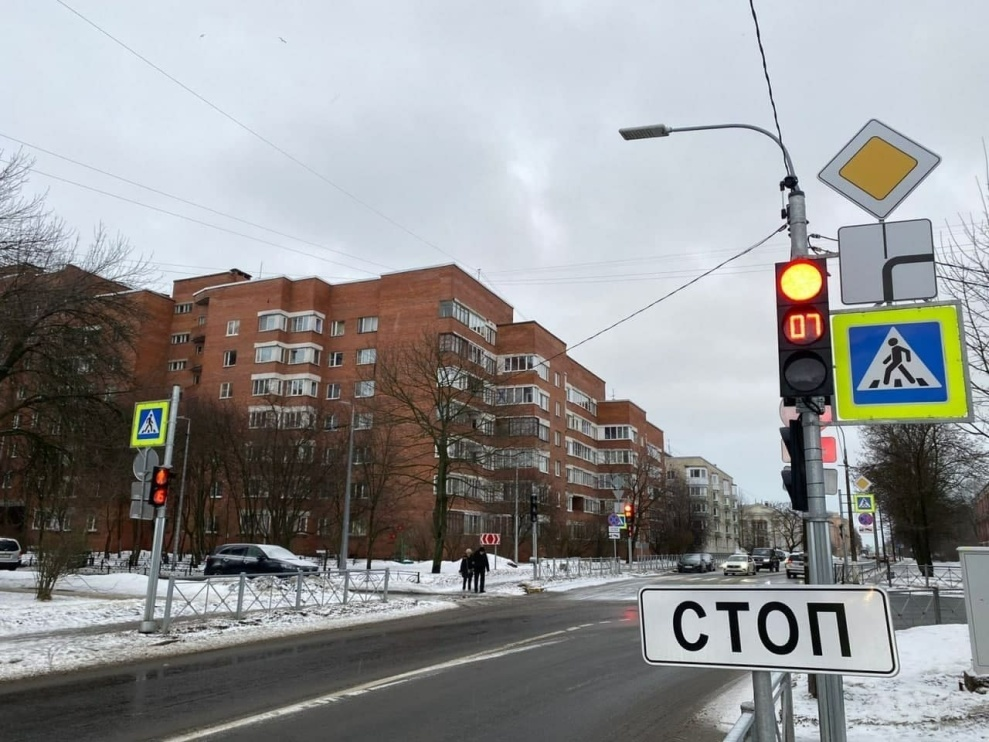

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp/3.jpg', width=600)

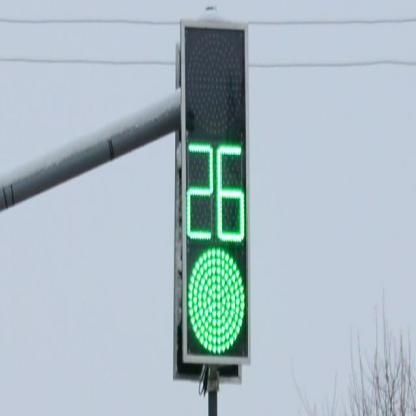

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp/5.jpg', width=600)

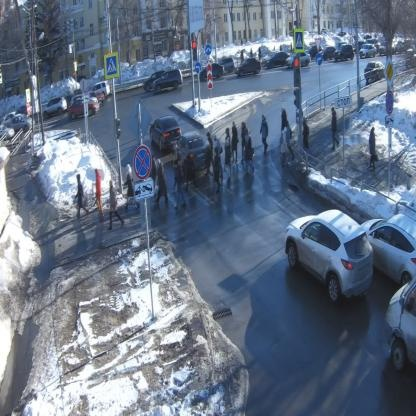

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp/6.jpg', width=600)

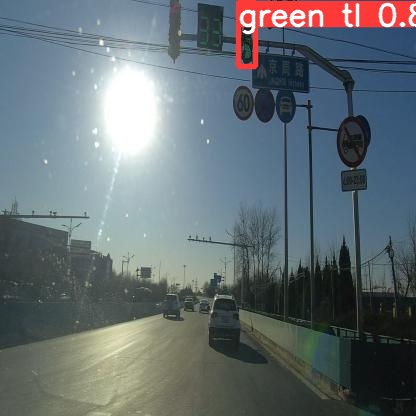

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp/7.jpg', width=600)

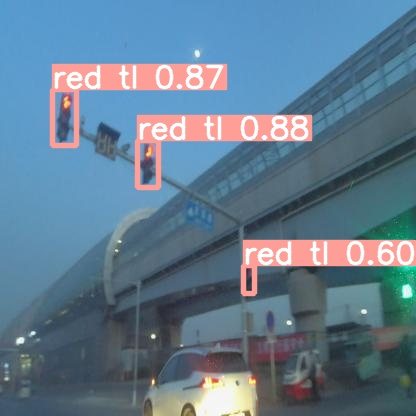

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp/8.jpg', width=600)

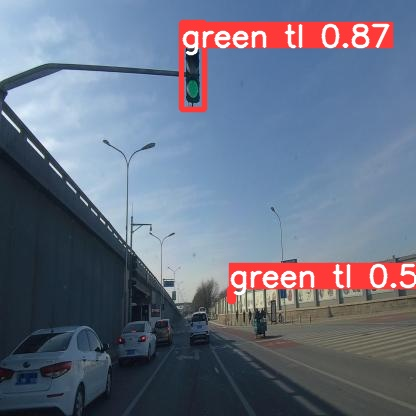

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp/9.jpg', width=600)

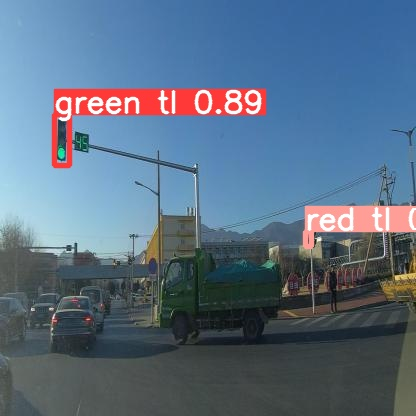

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp/10.jpg', width=600)

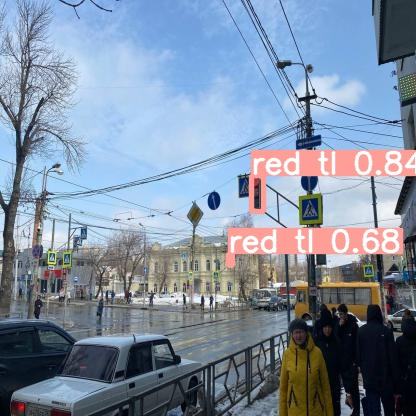

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp/11.jpg', width=600)

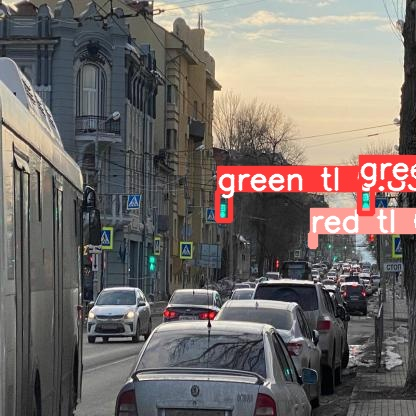

In [ ]:
display.Image(filename='/content/yolov5/runs/detect/exp/12.jpg', width=600)

# **Выводы**




*   На подготовительном этапе работ вручную было отработано 10000 фотографий в двух датасетах с kaggle. Было собрано два датасета первый на 2500 изображений  (train data = 2247, validation data = 222, test data = 43), второй, расширенный на 4100 изображений (train data = 3648, validation data = 348, test data = 76), включал в себя изображения из первого, а также фотографии, сделанные собственноручно.    
*   Модель была обучена на 500 эпохах, первые 300 эпох обучались на первой версии датасета, остальные 200 эпох на второй. 
*  Нейронная сеть имеет неплохую точность,  map .5 = 0.669, map .95: 0.317. Тестирование показывает, что модель справляется с поставленной задачей и спопобна детектировать и распознавать светофоры. Видны и слабые стороны модели: она плохо справляется со светофорами, которые расположены слишком близко к камере, с отдалёнными же справляется отлично. Я связываю такие результаты тестирования с тем, что в базе данных (особенно в первой версии бд) изображения были преимущественно со светофорами, находящимися далеко от наблюдателя. То есть устраненить данный недостаток модели возможно путём добавления в датасет большего количества изображений светофоров крупным планом.  


